In [1]:
import json
import re
import pandas as pd
import numpy as np
import ai
import os
import math
import random
import matplotlib.pyplot as plt
import time
import threading

In [ ]:
MB_TO_GB_s = 0.0009765625
PRICE_PER_GB_s = 0.0000166667
scores = []
RAM_LIST = list(range(128, 3072 ,64))
resultLock = threading.Lock()
executionResultLock = threading.Lock()
stop_threads = False


In [ ]:
def get_compiles_files_features(s3_path, task_name):
    compiles_ls_result = ls_aws_s3_and_capture(s3_path)
    all_sizes = re.findall('([0-9]+) \S*', compiles_ls_result)
    np_compiled_sizes = np.array(list(map(int, all_sizes)))
    file_size = int(find_file_size_s3([task_name], compiles_ls_result)[0])
    return dyscretize_file_sizes(file_size, np_compiled_sizes, buckets = 10)

In [ ]:
def ls_aws_s3_and_capture(s3_path):
    result = ! aws s3 ls {s3_path}
    return ' '.join(result)

In [ ]:
def get_tasks_count_map(workflow_file_path):
    with open(workflow_file_path) as json_workflow:
        process_number_map = {}
        data = json.load(json_workflow)
        for process in data['processes']:
            process_name = process['name']
            process_number_map = append_proccess_to_map(process_number_map, process_name)
        return process_number_map

In [ ]:
def append_proccess_to_map(process_number_map, process):
    if(process in process_number_map):
        process_number_map[process] += 1
    else:
        process_number_map[process] = 1
    return process_number_map

In [ ]:
def get_task_count_features(task_name, task_map):
    features = []
    features.append(task_map[task_name])
    sum_task_count = 0
    for task in task_map.keys():
        sum_task_count += task_map[task]
    features.append(int(10 * task_map[task_name] / sum_task_count))
    features.append(list(task_map.keys()).index(task_name))
    
    return features

In [ ]:
def get_files_sizes_features(files_sizes, all_files_sizes):
    size_features = []
    size_features.append(dyscretize_file_sizes(min(files_sizes), all_files_sizes))
    size_features.append(dyscretize_file_sizes(max(files_sizes), all_files_sizes))
    size_features.append(dyscretize_file_sizes(sum(files_sizes)/len(files_sizes), all_files_sizes))
    size_features.append(len(files_sizes))
                                               
    return size_features

In [ ]:
def find_file_size_s3(names, output):
    file_sizes = []
    for name in names:
        file_size = re.search('([0-9]+) ' + name, output)
        file_sizes.append(file_size.group(1))
    return file_sizes

In [ ]:
def dyscretize_file_sizes(file_size, all_files_sizes, buckets = 100):
    all_files_bins = np.linspace(all_files_sizes.min(), all_files_sizes.max(), buckets)
    digitized = np.digitize(file_size, bins=all_files_bins)
    return digitized

In [ ]:
def get_inout_files_features(s3_path, files):
    ls_result = ls_aws_s3_and_capture(s3_path)
    files_sizes = []
    for file in files:
        file_size = re.search('([0-9]+) ' + file['name'], ls_result)
        files_sizes.append(file_size.group(1))
    files_sizes = list(map(int, files_sizes))
    all_sizes = re.findall('([0-9]+) \S*', ls_result)
    np_sizes = np.array(list(map(int, all_sizes)))
    return get_files_sizes_features(files_sizes, np_sizes)

In [ ]:
def init_result_json():
    init_structure = {}
    for filename in os.listdir('./montage_0.35_single_tasks/'):
        if(filename.endswith('.json')):
            task_id = filename[:-5]
            init_structure[task_id] = {}
            for ram in RAM_LIST:
                init_structure[task_id][ram] = []
            init_structure[task_id]['core_features'] = []
    with open('./montage_0.35_single_tasks/utils/results.json', 'w+') as result_json:
        json.dump(init_structure, result_json, indent=4)

In [ ]:
def add_execution_result_to_json(task_id, result_dict, executionResultLock):
    executionResultLock.acquire()
    with open('./execution_data.json') as result_json:
        data = json.load(result_json)
    if 'montage_0.35' not in data:
        data['montage_0.35'] = []
    new_recort = {}
    
    new_recort['task_id'] = task_id
    for result_key in result_dict.keys():
        new_recort[result_key] = result_dict[result_key]
    
    data['montage_0.35'].append(new_recort)
    with open('./execution_data.json', 'w+') as result_json:
        json.dump(data, result_json, indent=4)
    executionResultLock.release()

In [ ]:
def get_core_features(task_id, task_name, ins, outs, task_count_map, resultLock):
    resultLock.acquire()
    with open('./montage_0.35_single_tasks/utils/results.json') as result_json:
        data = json.load(result_json)
    if len(data[task_id]['core_features']) > 0:
        resultLock.release()
        return data[task_id]['core_features']
        
    all_features = get_all_features(task_name, ins, outs, task_count_map)
    data[task_id]['core_features'] = list(map(int, all_features))
    with open('./montage_0.35_single_tasks/utils/results.json', 'w') as result_json:
        json.dump(data, result_json, indent=4)
    resultLock.release()
    return all_features
    

In [ ]:
def get_all_features(task_name, ins, outs, task_count_map):
    all_features = []
    all_features.extend(get_task_count_features(task_name, task_count_map))
    all_features.extend(get_inout_files_features('cegielskir/montageV2_6-0.35/', ins))
    all_features.extend(get_inout_files_features('cegielskir/montageV2_6-0.35/', outs))
    all_features.extend([(get_compiles_files_features('cegielskir/montageV2_6-compiles/', task_name))])
    return all_features             

In [ ]:
def time_roundup_and_return_in_sec(time):
    return int(math.ceil(time / 100.0)) /10

In [ ]:
def calculate_cost(ram, time):
    return ram * MB_TO_GB_s * PRICE_PER_GB_s * time_roundup_and_return_in_sec(time)

In [ ]:
def calculate_cost_time_value(time, cost):
    return (time +  35_000_000 * cost) / 40_000

In [ ]:
def execute_task_with_brain(task_id, task_name, config, ins, outs, brain, ram, core_features, resultLock, executionResultLock):
    resultLock.acquire()
    with open('./montage_0.35_single_tasks/utils/results.json') as result_json:
        data = json.load(result_json)
    resultLock.release()
    if data[task_id][str(ram)] == None:
        data[task_id][str(ram)] = [] 
    if len(data[task_id][str(ram)]) == 0:
        all_features = execute_and_save_results(data, task_id, config, ins, outs, ram, core_features[:], executionResultLock)
        resultLock.acquire()
        with open('./montage_0.35_single_tasks/utils/results.json') as result_json:
            data = json.load(result_json)
        data[task_id][str(ram)].append(all_features)
        with open('./montage_0.35_single_tasks/utils/results.json', 'w') as result_json:
            json.dump(data, result_json, indent=4)
        resultLock.release()
    else:
        all_features = random.choice(data[task_id][str(ram)])
        
    old_reward = all_features[0]
    new_ram_id = brain.update(old_reward, all_features[1:])
    scores.append(brain.score())
    new_correct_ram = RAM_LIST[new_ram_id]
    new_all_features = execute_and_save_results(data, task_id, config, ins, outs, new_correct_ram, core_features[:], executionResultLock)

    resultLock.acquire()

    with open('./montage_0.35_single_tasks/utils/results.json') as result_json:
        data = json.load(result_json)
    data[task_id][str(new_correct_ram)].append(new_all_features)
    with open('./montage_0.35_single_tasks/utils/results.json', 'w') as result_json:
        data = json.dump(data, result_json, indent=4)
    resultLock.release()

    new_reward = new_all_features[0]
    if old_reward == -1:
        final_reward = new_reward * 10.0
    else:
        final_reward = (new_reward - old_reward) * 10.0
        
    if new_all_features[14] == -1:
        final_reward = -1.0
    elif task_name == 'mProject':
        final_reward = final_reward * 0.09
    elif task_name == 'mDiffFit':
        final_reward = final_reward * 0.5
    elif task_name == 'mBackground':
        final_reward = final_reward * 0.43
    elif task_name == 'mAdd':
        final_reward = final_reward * 0.25
    elif task_name == 'mConcatFit' or task_name == 'mImgtbl':
        final_reward = final_reward * 0.4
    elif task_name == 'mBgModel':
        final_reward = final_reward * 0.2
    elif task_name == 'mViewer':
        final_reward = final_reward * 0.33

    brain.feedback_and_reset(final_reward, new_all_features[1:])
    print('RAM ' + str(task_id) + ' FROM: ' + str(ram) + ' --> ' + str(new_correct_ram) + ' reward: ' + str(final_reward))

    

In [ ]:
list = [1,2,3]
list[1:]

In [ ]:
def execute_and_save_results(data, task_id, config, ins, outs, ram, core_features, executionResultLock):
    try:
        
        result = execute_workflow_task(config, ins, outs, ram)
        time_dict = extract_times_from_result_string(result)
        lambda_time = time_dict['lambda_end_time'] - time_dict['lambda_start_time']
        download_time = time_dict['download_end_time'] - time_dict['download_start_time']
        upload_time = time_dict['upload_end_time'] - time_dict['upload_start_time']
        execution_time = time_dict['execution_end_time'] - time_dict['execution_start_time']
        core_features.append(int(lambda_time/100))
        core_features.append(int(download_time/100))
        core_features.append(int(upload_time/100))
        core_features.append(int(execution_time/100))

        cost = calculate_cost(ram, lambda_time)    
        core_features.append(int( 360_000 * cost))

        result_json_dict = {}
        result_json_dict['lambda_time'] = lambda_time
        result_json_dict['download_time'] = download_time
        result_json_dict['upload_time'] = upload_time
        result_json_dict['execution_time'] = execution_time
        result_json_dict['ram'] = str(ram)
        result_json_dict['cost'] = cost
        result_json_dict['ts'] = str(time.time())
        add_execution_result_to_json(task_id, result_json_dict, executionResultLock)
        core_features.insert(0,RAM_LIST.index(ram))
        core_features.insert(0,calculate_cost_time_value(lambda_time, cost))
    except AttributeError:
        result_json_dict = {}
        result_json_dict['lambda_time'] = -1
        result_json_dict['download_time'] = -1
        result_json_dict['upload_time'] = -1
        result_json_dict['execution_time'] = -1
        result_json_dict['ram'] = str(ram)
        result_json_dict['cost'] = -1
        result_json_dict['ts'] = str(time.time())
        add_execution_result_to_json(task_id, result_json_dict, executionResultLock)
        
        core_features.append(-1)
        core_features.append(-1)
        core_features.append(-1)
        core_features.append(-1)
        core_features.append(-1)
        core_features.insert(0,RAM_LIST.index(ram))
        core_features.insert(0,-1)

    return core_features

In [ ]:
def execute_workflow_task(config, ins, outs, ram):
    os.environ['FUNCTION_TYPE'] = str(ram)
    ins_arg = json.dumps(ins)
    outs_arg = json.dumps(outs)
    config_arg = json.dumps(config)
    result = !node awsLambdaCommand.js {"'" + ins_arg + "'"} {"'" + outs_arg + "'"} {"'" + config_arg + "'"}
    return ' '.join(result)

In [ ]:
def extract_times_from_result_string(result):
    times_dict = {}
    times_dict['download_start_time'] = int(re.search('download start: (.+?) ', result).group(1))
    times_dict['download_end_time'] = int(re.search('download end: (.+?) ', result).group(1))
    times_dict['upload_start_time'] = int(re.search('upload start: (.+?) ', result).group(1))
    times_dict['upload_end_time'] = int(re.search('upload end: (.+?) ', result).group(1))
    times_dict['execution_start_time'] = int(re.search('execution start: (.+?) ', result).group(1))
    times_dict['execution_end_time'] = int(re.search('execution end: (.+?) ', result).group(1))
    times_dict['lambda_start_time'] = int(re.search('lambda start: (.+?) ', result).group(1))
    times_dict['lambda_end_time'] = int(re.search('lambda end: (.+?) ', result).group(1))
    return times_dict

In [ ]:
def clear_ram_execution_results():
    with open('./montage_0.35_single_tasks/utils/results.json') as result_json:
        data = json.load(result_json)
    for json_key in data.keys():
        for ram in RAM_LIST:
            if str(ram) in data[json_key]:
                del(data[json_key][str(ram)])
            
        for new_ram in RAM_LIST:
            data[json_key][str(new_ram)] = []

    with open('./montage_0.35_single_tasks/utils/results.json', 'w') as result_json:
        data = json.dump(data, result_json, indent=4)

In [ ]:
def clear_core_features():
    
    task_map = get_tasks_count_map('./montage_0.35_single_tasks/utils/workflow.json')
    with open('./montage_0.35_single_tasks/utils/results.json') as result_json:
        data = json.load(result_json)
    for json_key in data.keys():
        data[json_key]['core_features'][2] = list(task_map.keys()).index(json_key.split('_')[0])
    with open('./montage_0.35_single_tasks/utils/results.json', 'w') as result_json:
        data = json.dump(data, result_json, indent=4)

In [ ]:
#clear_core_features()

In [ ]:
#clear_ram_execution_results()

In [ ]:
def find_nearest(array, value):
    array = np.asarray(array)
    idx = (abs(array - value)).argmin()
    return array[idx]

In [ ]:
def save(brain):
    print('Saving ...')
    brain.save()
    plt.plot(scores)
    plt.show()

In [ ]:
_size_s3([task_name], s3_files_compiles.stdout)
    print(dyscretize_file_sizes(int(exec_size[0]), np_compiled_sizes, buckets = 10))  

In [ ]:
%%capture s3_files_compiles
! aws s3 ls cegielskir/montageV2_6-compiles/

In [ ]:
all_sizes = re.findall('([0-9]+) \S*\\r', s3_files_compiles.stdout)
np_sizes = np.array(list(map(int, all_sizes)))

In [ ]:
brain = Dqn(18, len(RAM_LIST), 0.9)


In [ ]:
def init(threadID, resultLock, executionResultLock):
    #brain.load()
    task_count_map = get_tasks_count_map('./montage_0.35_single_tasks/utils/workflow.json')
    iteration = 0
    while not stop_threads:
        filename = random.choice(os.listdir('./montage_0.35_single_tasks/'))
        if stop_threads:
            break
        if(filename.endswith('.json')):
            with open('./montage_0.35_single_tasks/' + filename) as single_workflow:
                print('Thread: ' + str (threadID) + ' iteration: ' + str(iteration))
                iteration += 1
                task_id = filename[:-5]
                data = json.load(single_workflow)
                task_name = data['processes'][0]['name']
                process = data['processes'][0]
                config = process['config']
                config['workdir'] = './montage_0.35_single_tasks'
                ins = [ data['signals'][i] for i in process['ins'] ]
                outs = [ data['signals'][i] for i in process['outs'] ]
                core_features = get_core_features(task_id, task_name, ins, outs, task_count_map, resultLock)
                ram = random.choice(RAM_LIST)
                execute_task_with_brain(task_id, task_name, config, ins, outs, brain, ram, core_features, resultLock, executionResultLock)

                if iteration % 10 == 0:
                    save(brain)
    print('Terminated')

In [ ]:
resultLock = threading.Lock()
executionResultLock = threading.Lock()
init('1', resultLock, executionResultLock)

In [ ]:
resultLock = threading.Lock()
executionResultLock = threading.Lock()

#init(resultLock, executionResultLock)
thread1 = threading.Thread(target=init, args=('1', resultLock, executionResultLock))
thread1.start()
thread2 = threading.Thread(target=init, args=('2',resultLock, executionResultLock))
thread2.start()
thread3 = threading.Thread(target=init, args=('3',resultLock, executionResultLock))
thread3.start()
thread4 = threading.Thread(target=init, args=('4',resultLock, executionResultLock))
thread4.start()
thread5 = threading.Thread(target=init, args=('5',resultLock, executionResultLock))
thread5.start()
thread6 = threading.Thread(target=init, args=('6',resultLock, executionResultLock))
thread6.start()
thread1.join()
thread2.join()
thread3.join()
thread4.join()
thread5.join()
thread6.join()

In [ ]:
thread2.is_alive()

In [ ]:
def check(lock):
    lock.acquire()
    print('cos')
    lock.release()

In [ ]:
stop_threads = True

In [ ]:
MB_TO_GB_s = 0.0009765625
PRICE_PER_GB_s = 0.0000166667

In [ ]:
128 * MB_TO_GB

In [ ]:
1024 * MB_TO_GB * 0.0000166667

In [ ]:
ins

In [ ]:
%%capture s3_filesstate_dict
! aws s3 ls cegielskir/montageV2_6-0.35/

In [ ]:
%%capture s3_files_compiles
! aws s3 ls cegielskir/montageV2_6-compiles/

In [ ]:
all_sizes = re.findall('([0-9]+) \S*\\r', s3_files.stdout)
np_sizes = np.array(list(map(int, all_sizes)))

In [ ]:
ins_files_sizes = []
for in_file in ins:
    file_size = re.search('([0-9]+) ' + in_file['name'], s3_files.stdout)
    ins_files_sizes.append(file_size.group(1))
ins_files_sizes = list(map(int, ins_files_sizes))
get_files_sizes_features(ins_files_sizes, np_sizes)

In [ ]:
out_files_sizes = []
for out_file in outs:
    file_size = re.search('([0-9]+) ' + out_file['name'], s3_files.stdout)
    out_files_sizes.append(file_size.group(1))
out_files_sizes = list(map(int, out_files_sizes))
get_files_sizes_features(out_files_sizes, np_sizes)

In [ ]:
outs

In [ ]:
all_sizes = re.findall('([0-9]+) \S*\\r', s3_files.stdout)
np_sizes = np.array(list(map(int, all_sizes)))

In [ ]:
sizes_series.plot.hist(bins=20)

In [ ]:
all_files_bins = np.linspace(np_sizes.min(), np_sizes.max(), 20)
digitized = np.digitize(np_sizes, bins=all_files_bins)
digitized

In [ ]:
pd.cut(x=np_sizes, bins=20)

In [ ]:
saved_memory = brain.memory

In [3]:
len(saved_memory.memory)







NameError: name 'saved_memory' is not defined

In [2]:
execs = pd.read_csv('./../data/execs.csv')
snaps = pd.read_csv('./../data/snaps.csv')
allDf = pd.concat([execs, snaps])

In [211]:
dfSes = allDf[allDf['value'] == 'T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xziATHElGn6MbAADAY1C7I5L6WCBIRgLz81HhKsChLyr3L5BnNlUj4dWBz2Y+7TtuNSyRfFqOtdLSu8MP5PSvVcXcpJovj18L/BwaSqeaA6Ausea10IWDwChV8NQOG5hNliKN5LjUJfQixkjgSpjhx5jesTy+/eIU2pENDCjKF6jEfLTYC1cUDw2WITegG3f1TVvynkU6Erk7yv5c8c+5DUPCBxsiYji8/bcLnnCL5AYF7NYXZ2iiYt3hKPMWwIMbQEtBu5Fcb30x+XwV']
dfSes['pnr_locator'] = dfSes['pnr_locator'].astype(str)
dfSes = dfSes.sort_values(by=['evn_tms'])
dfSes = dfSes.reset_index()
# print(dfSes.head(50))
# elmntIds = set(dfSes['elmnt_id'].values)
# ll = len(elmntIds)
# elmntIdMap = {}
# for elmntId in elmntIds:
#     if len(elmntIdMap) == 0:
#         elmntIdMap[elmntId] = 0
#     if elmntId not in elmntIdMap:
#         elmntIdMap[elmntId] = max(elmntIdMap.values()) + 1

# maxElmntId = max(elmntIdMap.values())
# for entry in elmntIdMap:
#     elmntIdMap[entry] = elmntIdMap[entry]/maxElmntId
    
# cmndGroups = set(dfSes['command_group'].values)
# cmndGroupMap = {}
# cmndGroupMap['NGV://RESERVATIONSCOPE/LOCATOR'] = 0 
# for cmndGroup in cmndGroups:
#     if len(cmndGroupMap) == 0:
#         cmndGroupMap[cmndGroup] = 0
#     if cmndGroup not in cmndGroupMap:
#         cmndGroupMap[cmndGroup] = max(cmndGroupMap.values()) + 1
# cmndGroupMap['NGV://RESERVATIONSCOPE/LOCATOR'] = 94 

# maxElmntId = max(cmndGroupMap.values())
# for entry in cmndGroupMap:
#     cmndGroupMap[entry] = cmndGroupMap[entry]/maxElmntId
    
# print(cmndGroupMap)

<ipython-input-211-31e1d8f7fe8d>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfSes['pnr_locator'] = dfSes['pnr_locator'].astype(str)


In [227]:
print(getWrongPnrCount(testDf))


43


43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


<ipython-input-226-993ff3cec13c>:59: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.
  probs = F.softmax(self.model(Variable(state, volatile = True))*100)
<ipython-input-226-993ff3cec13c>:59: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  probs = F.softmax(self.model(Variable(state, volatile = True))*100)


Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 24
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 34
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 44
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 54
Wrong pn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 312
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 314
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 324
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 334
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 594
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 604
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 614
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 884
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 894
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 904
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1164
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1174
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1184
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1444
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1454
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1464
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1734
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1744
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1754
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2014
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2024
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2034
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2294
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2304
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2314
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2324
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57


Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2584
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2594
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2604
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wro

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2864
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2874
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2884
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3144
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3154
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3164
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wro

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3424
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3434
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3444
Wrong pnr snap: 57
Action:1
RESET: 3445
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3704
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3714
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3724
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3984
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3994
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4004
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wro

Action:0
Wrong pnr snap: 57
Action:1
RESET: 4264
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4274
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4284
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4294
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57


Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4554
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4564
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4574
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wro

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4834
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4844
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4854
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4864
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5124
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5134
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5144
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 57
Action:1
RESET: 5394
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5404
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5414
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5424
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57


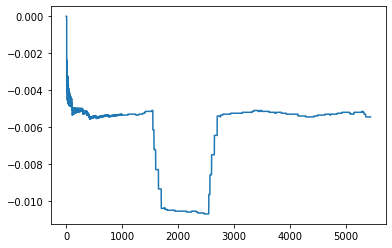

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 21
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 31
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 35
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 41
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 301
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 311
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 321
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:1
RESET: 581
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 591
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 601
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 611
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 871
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 881
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 891
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1151
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1161
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1171
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1431
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1441
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1451
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 61
Action:1
RESET: 1711
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1721
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1731
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1741
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Action:0
Wrong pnr snap: 64
Action:1
RESET: 1991
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2001
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2011
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2021
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2276
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2281
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2291
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2301
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2561
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2571
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2581
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2837
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2841
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2851
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2861
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3121
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3131
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3141
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RES

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3401
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3409
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3411
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3421
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3431
Wrong p

Action:0
Wrong pnr snap: 64
Action:1
RESET: 3681
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3691
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3701
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3711
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3971
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3981
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3991
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4251
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4261
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4271
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4541
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4551
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4561
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4821
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4831
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4841
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5101
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5111
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5121
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5131
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5391
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5401
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5411
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

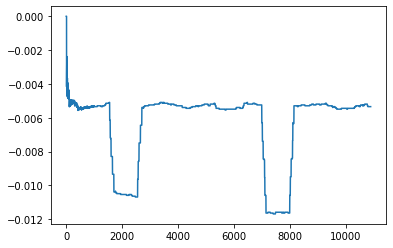

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 18
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 28
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 38
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 48
Wrong pnr snap: 43
Actio

Action:1
RESET: 298
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 308
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 318
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 328
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 588
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 598
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 608
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 868
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 878
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 888
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 898
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Action:1
RESET: 1148
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1158
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1168
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1178
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Action:1
RESET: 1428
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1438
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1448
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1458
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Action:0
Wrong pnr snap: 54
Action:0
Wrong pnr snap: 54
Action:0
Wrong pnr snap: 54
Action:0
Wrong pnr snap: 54
Action:0
Wrong pnr snap: 54
Action:0
Wrong pnr snap: 54
Action:0
Wrong pnr snap: 54
Action:1
RESET: 1718
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1728
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1738
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1998
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2008
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2018
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2278
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2288
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2298
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2558
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2568
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2578
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2838
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2848
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2854
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2858
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55


Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3118
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3128
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3130
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3138
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3148
Wrong p

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3398
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3408
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3418
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3421
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3428
Wrong pnr snap: 

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3688
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3698
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3708
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3968
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3978
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3988
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4248
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4258
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4268
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4278


Action:0
Wrong pnr snap: 55
Action:1
RESET: 4528
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4538
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4548
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4558
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4818
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4828
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4835
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4838
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0


Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5098
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5108
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5118
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5378
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5388
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5398
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

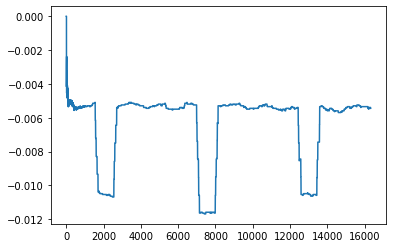

43
Action:1
RESET: 15
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 25
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 35
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 45
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 305
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 315
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 325
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 585
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 595
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 605
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Action:1
RESET: 865
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 875
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 885
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 895
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1155
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1165
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1175
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1435
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1445
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1455
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1465
Wrong pnr snap: 43


Action:1
RESET: 1715
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1725
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1735
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1741
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1745
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong p

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2005
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2015
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2025
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2285
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2295
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2297
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2305
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2565
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2575
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2585
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2595
Wrong pnr snap: 67
Action:1
RESET: 2596
Wrong pnr snap: 

Wrong pnr snap: 67
Action:1
RESET: 2845
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2855
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2865
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2875
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0


Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3135
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3145
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3155
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wro

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3415
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3425
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3435
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3695
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3705
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3715
Wrong pnr snap: 67
Action:1
RESET: 3716
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3973
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3975
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3985
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3995
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4255
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4265
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4275
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4285
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4545
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4555
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4565
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4825
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4833
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4835
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4845
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5105
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5115
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5125
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5385
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5395
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5405
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

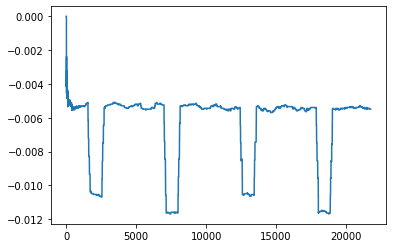

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 22
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 32
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 42
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:1
RESET: 302
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 312
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 322
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 332
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 592
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 602
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 612
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 872
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 882
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 892
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 895
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESE

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1152
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1162
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1172
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1182
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1442
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1452
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1462
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1722
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1732
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1742
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1746
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2002
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2012
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2022
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2032


Wrong pnr snap: 63
Action:1
RESET: 2282
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2292
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2302
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2311
Wrong pnr snap: 63
Action:1
RESET: 2312
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2572
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2582
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2592
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2852
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2862
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2872
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RES

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3142
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3152
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3162
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3422
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3432
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3442
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3702
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3712
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3722
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3732
Wrong pnr snap: 63
Action:0


Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3992
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4002
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4012
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4272
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4282
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4292
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:1
RESET: 4552
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4562
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4572
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4582
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4584
Wrong pnr snap: 

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4842
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4852
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4862
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5122
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5132
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5142
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5402
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5412
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5422
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5427
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63


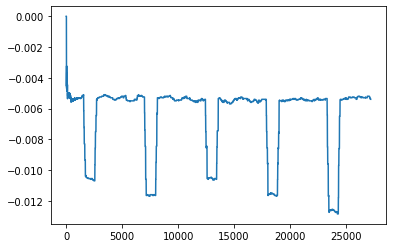

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 19
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 29
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 39
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 299
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 309
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 319
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 329
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 589
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 599
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 609
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:1
RESET: 869
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 879
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 889
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 899
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1159
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1169
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1179
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1439
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1449
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1459
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1719
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1729
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1739
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1749


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2009
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2019
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2029
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2289
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2299
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2309
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2319
Wrong pnr snap: 61
Action:0


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2579
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2589
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2599
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2859
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2869
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2879
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3139
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3149
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3159
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3169


Action:1
RESET: 3419
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3429
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3439
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3449
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3709
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3719
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3729
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3999
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4009
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4019
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4279
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4289
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4299
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4559
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4569
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4578
Wrong pnr snap: 61
Action:1
RESET: 4579
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4585
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4589
Wrong pnr snap: 61
Acti

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4849
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4859
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4869
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5129
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5139
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5149
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5159


Action:0
Wrong pnr snap: 61
Action:1
RESET: 5409
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5419
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5429
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5439
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


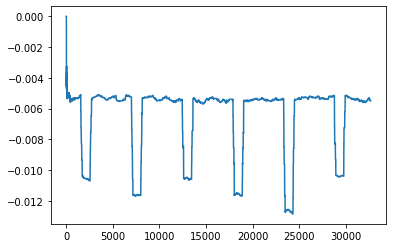

43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 16
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 26
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 36
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 46
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 306
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 316
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 326
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 586
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 596
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 606
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 609
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 866
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 876
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 886
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1156
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1166
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1176
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1431
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1436
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1446
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1456
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 1716
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 1726
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 1736
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wro

Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 1996
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 2006
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 2016
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wro

Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 2276
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 2286
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 2296
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 2306
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0


Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 2562
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 2566
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 2576
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 2586
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65


Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 2846
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 2856
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 2866
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 3126
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 3136
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 3146
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 3149
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65


Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 3406
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 3416
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 3426
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 3436
Wrong pnr snap: 65
Action:0


Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 3686
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 3696
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 3706
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 3716
Wrong pnr snap: 65
Action:0


Wrong pnr snap: 65
Action:1
RESET: 3966
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 3976
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 3986
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 3996
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0


Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 4256
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 4266
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 4276
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr sn

Action:1
RESET: 4536
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 4546
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 4556
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 4566
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65


Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 4826
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 4836
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 4846
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wro

Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 5106
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 5116
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 5126
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 5136
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65


Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 5386
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 5396
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 5406
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65
Action:1
RESET: 5416
Wrong pnr snap: 65
Action:0
Wrong pnr snap: 65


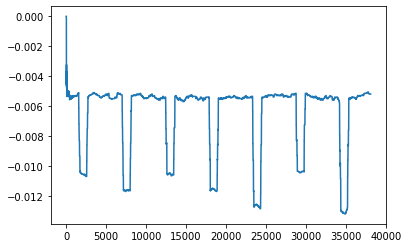

43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 16
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 23
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 33
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 43
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 303
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 313
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 323
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 583
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 593
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 603
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:1
RESET: 863
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 873
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 883
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 893
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1153
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1163
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1173
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:1
RESET: 1433
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1443
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1453
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1463
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 1723
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 1733
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 1743
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 2003
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 2013
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 2023
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 2030
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59


Wrong pnr snap: 59
Action:1
RESET: 2283
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 2293
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 2303
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 2313
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0


Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 2573
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 2583
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 2593
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wro

Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 2853
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 2863
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 2873
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 3133
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 3143
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 3153
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RES

Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 3423
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 3433
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 3443
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr sn

Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 3703
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 3713
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 3723
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 3983
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 3993
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 4003
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 4013
Wrong pnr snap: 59


Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 4273
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 4283
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 4293
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr sn

Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 4553
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 4563
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 4573
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr sn

Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 4833
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 4843
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 4853
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 4863


Wrong pnr snap: 59
Action:1
RESET: 5113
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 5123
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 5133
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 5143
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0


Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 5403
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 5413
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:1
RESET: 5423
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wrong pnr snap: 59
Action:0
Wro

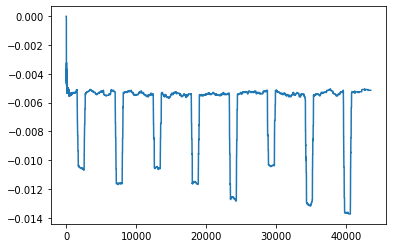

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 20
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 30
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 40
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 310
Wrong pnr snap: 43
Action:1
RESET: 311
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 320
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 330
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 590
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 600
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 610
Wrong pnr snap: 43
Action:1
RESET: 611
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 870
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 880
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 890
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 900
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1150
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1160
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1170
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1180
Wrong pnr snap: 43
Action:0


Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1440
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1450
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1460
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1720
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1730
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1740
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1750


Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2000
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2010
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2020
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2030
Wrong pnr snap: 70


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2280
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2290
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2300
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2310
Wrong pnr snap: 70
Action:0


Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2565
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2570
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2580
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2590
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70


Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2850
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2860
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2870
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3130
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3132
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3140
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3150
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3160
Wrong pnr snap: 

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3420
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3430
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3440
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3700
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3710
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3720
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3980
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3990
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4000
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4260
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4270
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4280
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RES

Action:1
RESET: 4540
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4550
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4560
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4570
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70


Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4830
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4840
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4850
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5110
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5120
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5130
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5400
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5410
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5420
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

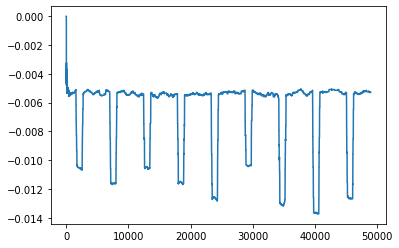

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 17
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 27
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 37
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 47
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 307
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 317
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 327
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 587
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 597
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 607
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 617
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 867
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 877
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 887
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 897
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:1
RESET: 1147
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1157
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1167
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1177
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1437
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1447
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1457
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 1717
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1727
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1737
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1997
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2007
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2017
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2277
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2287
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2297
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2307
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2567
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2577
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2587
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2847
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2857
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2867
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3127
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3137
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3147
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3407
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3417
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3427
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RES

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3687
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3697
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3707
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3717
Wrong pnr snap: 58


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3977
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3987
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3997
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4257
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4267
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4277
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4537
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4547
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4557
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RES

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4827
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4837
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4847
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5107
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5117
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5127
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5137
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5397
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5407
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5417
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

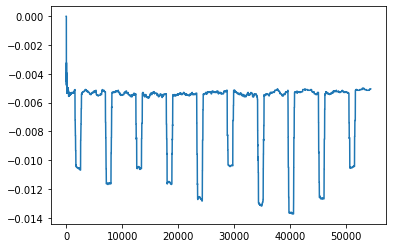

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 24
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 34
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 44
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 304
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 314
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 324
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Wrong pnr snap: 43
Action:1
RESET: 584
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 594
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 604
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 614
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 874
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 884
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 894
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:1
RESET: 1154
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1164
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1174
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1184
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1444
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1454
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1464
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1724
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1734
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1744
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1754


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2004
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2014
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2024
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2034
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2294
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2304
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2314
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2574
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2584
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2594
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2597
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2854
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2864
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2874
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3134
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3144
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3154
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3164
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:1
RESET: 3414
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3424
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3434
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3444
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3704
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3714
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3724
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3984
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3989
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3994
Wrong pnr snap: 58
Action:1
RESET: 3995
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4004
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong p

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4264
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4274
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4284
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4294
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4554
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4564
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4574
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4834
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4844
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4854
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5114
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5124
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5134
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5394
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5404
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5414
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5424
Wrong pnr snap: 58


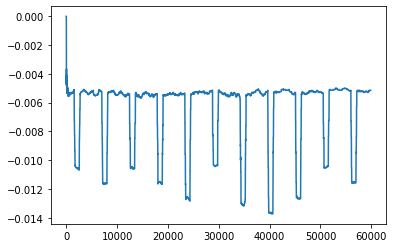

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 21
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 31
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 41
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:1
RESET: 301
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 311
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 321
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 331
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 591
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 601
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 611
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 871
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 880
Wrong pnr snap: 43
Action:1
RESET: 881
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 891
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 901
Wrong pnr snap: 43
Ac

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1156
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1161
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1171
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1181
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1441
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1451
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1461
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1721
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1731
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1741
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1751
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Action:0
Wrong pnr snap: 64
Action:1
RESET: 2001
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2011
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2021
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2031
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2291
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2301
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2311
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2571
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2581
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2591
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2851
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2861
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2871
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RES

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3141
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3151
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3161
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3421
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3431
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3441
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3701
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3711
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3721
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3981
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3991
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4001
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4011
Wrong pnr snap: 64


Action:1
RESET: 4258
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4261
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4271
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4281
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4291
Wrong p

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4541
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4551
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4561
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4571
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4831
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4841
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4851
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5111
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5121
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5131
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5141
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5401
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5411
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5421
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

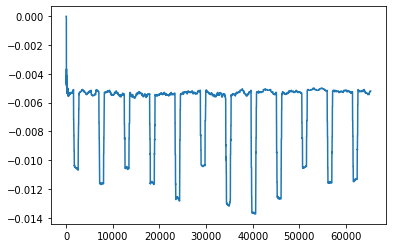

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 18
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 28
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 37
Wrong pnr snap: 43
Action:1
RESET: 38
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 48
Wrong pnr snap

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 308
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 318
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 328
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 588
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 598
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 608
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 618
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 878
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 888
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 898
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1158
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1168
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1178
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1438
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1448
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1458
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:0
Wrong pnr snap: 54
Action:0
Wrong pnr snap: 54
Action:0
Wrong pnr snap: 54
Action:0
Wrong pnr snap: 54
Action:0
Wrong pnr snap: 54
Action:1
RESET: 1718
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1728
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1738
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1998
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2008
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2018
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2028


Action:1
RESET: 2278
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2281
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2288
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2298
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2308
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong p

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2568
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2578
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2588
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2848
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2858
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2868
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2878
Wrong pnr snap: 55
Action:0


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3138
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3148
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3158
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3418
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3428
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3438
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3448
Wrong pnr snap: 55


Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3705
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3708
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3718
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3728
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55


Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3988
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3998
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4008
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4268
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4278
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4288
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4548
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4558
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4568
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4578
Wrong pnr snap: 55


Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4828
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4838
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4848
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4858
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55


Action:0
Wrong pnr snap: 55
Action:1
RESET: 5108
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5118
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5128
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5138
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55


Action:1
RESET: 5388
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5398
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5408
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5418
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55


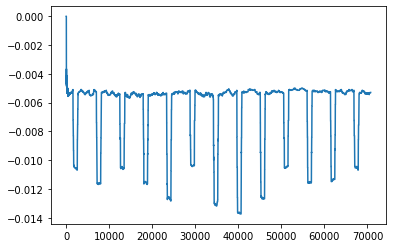

43
Action:1
RESET: 15
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 25
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 35
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 45
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 305
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 315
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 325
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 585
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 595
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 605
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 865
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 875
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 885
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 895
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1155
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1165
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1175
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1435
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1445
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1455
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RES

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1725
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1735
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1745
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2005
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2015
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2019
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2025
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2035
Wrong p

Wrong pnr snap: 67
Action:1
RESET: 2285
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2295
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2305
Wrong pnr snap: 67
Action:1
RESET: 2306
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2315
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2575
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2585
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2595
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2851
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2855
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2865
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2875
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3135
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3145
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3155
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3165
Wrong pnr snap: 67


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3415
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3425
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3435
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3445
Wrong pnr snap: 67
Action:0


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3705
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3715
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3725
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3985
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3995
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4005
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4015
Wrong pnr snap: 67


Wrong pnr snap: 67
Action:1
RESET: 4265
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4275
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4285
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4295
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4555
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4565
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4575
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4835
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4845
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4855
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wro

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5115
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5125
Wrong pnr snap: 67
Action:1
RESET: 5126
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5135
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5145
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5405
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5415
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5425
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

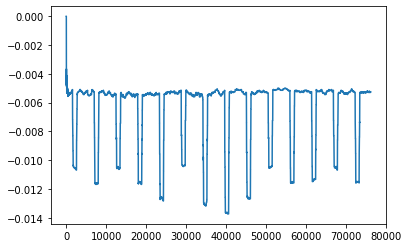

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 22
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 32
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 42
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 302
Wrong pnr snap: 43
Action:1
RESET: 303
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 312
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 317
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 322
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 582
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 592
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 602
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 612
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 872
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 882
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 892
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1152
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1162
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1172
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1182
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1442
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1452
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1462
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1722
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1732
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1742
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1752
Wrong pnr snap: 61
Action:0


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2002
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2012
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2022
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2032
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2292
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2302
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2312
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2572
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2582
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2592
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2602
Wrong pnr snap: 61
Action:0


Action:1
RESET: 2852
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2862
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2872
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2882
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3142
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3152
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3162
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3422
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3432
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3442
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Action:1
RESET: 3702
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3712
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3722
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3732
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3992
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4002
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4012
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4272
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4282
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4292
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RES

Action:0
Wrong pnr snap: 61
Action:1
RESET: 4552
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4562
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4572
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4582
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4842
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4852
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4862
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5122
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5132
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5142
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5152
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:1
RESET: 5402
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5412
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5422
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5432
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


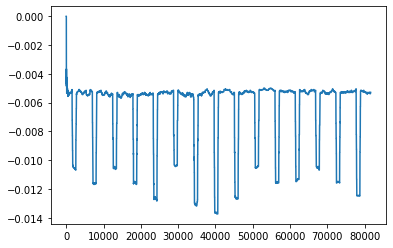

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 19
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 29
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 39
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 299
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 309
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 319
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 329
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 589
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 599
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 609
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 869
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 879
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 889
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 899
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:1
RESET: 1149
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1159
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1169
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1179
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1439
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1449
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1459
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1719
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1729
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1739
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1999
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2009
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2019
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2029
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:1
RESET: 2279
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2289
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2299
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2309
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2569
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2579
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2589
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2849
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2859
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2869
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 61
Action:1
RESET: 3129
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3139
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3149
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3159
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3419
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3429
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3439
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3699
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3709
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3719
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3979
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3989
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3999
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4009
Wrong pnr snap: 61
Action:0


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4269
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4279
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4289
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4549
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4559
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4569
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4829
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4839
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4849
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5109
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5119
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5129
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5389
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5399
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5409
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

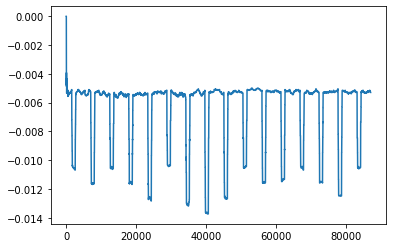

43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 16
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 26
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 36
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 46
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 306
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 316
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 326
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 586
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 596
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 606
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 866
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 876
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 886
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 896
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1146
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1156
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1159
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1166
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1176
Wrong pnr snap: 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1436
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1446
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1456
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 60
Action:0
Wrong pnr snap: 60
Action:0
Wrong pnr snap: 60
Action:0
Wrong pnr snap: 60
Action:0
Wrong pnr snap: 60
Action:0
Wrong pnr snap: 60
Action:1
RESET: 1716
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1726
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1736
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1996
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2006
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2016
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2026
Wrong pnr snap: 63
Action:0


Wrong pnr snap: 63
Action:1
RESET: 2276
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2286
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2296
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2306
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0


Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2566
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2576
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2586
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2846
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2856
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2866
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3126
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3136
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3146
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3156
Wrong pnr snap: 63
Action:0


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3406
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3416
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3426
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3436
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0


Action:1
RESET: 3686
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3696
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3706
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3716
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3976
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3986
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3996
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4256
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4266
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4276
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4536
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4546
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4556
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4816
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4826
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4836
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4843
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4846
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 

Action:1
RESET: 5096
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5106
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5116
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5126
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5386
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5396
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5406
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

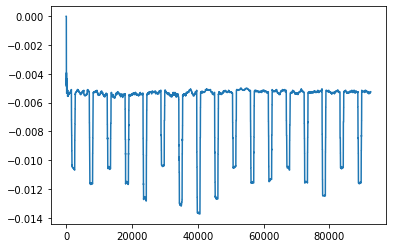

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 23
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 33
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 43
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 303
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 313
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 323
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 333
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 583
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 593
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 603
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 613
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 873
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 883
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 893
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:1
RESET: 1153
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1163
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1166
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1173
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1183
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong p

Action:1
RESET: 1433
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1443
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1453
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1463
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1723
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1733
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1743
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2003
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2013
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2023
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2033
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2293
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2303
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2313
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2573
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2583
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2593
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2853
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2860
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2863
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2873
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3133
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3137
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3143
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3153
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3163
Wrong pnr snap: 

Action:0
Wrong pnr snap: 58
Action:1
RESET: 3413
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3423
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3433
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3443
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3703
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3713
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3723
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3983
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3993
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4003
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4013
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4263
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4273
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4283
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4293
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4553
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4563
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4573
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4833
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4843
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4853
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5113
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5123
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5133
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5393
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5403
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5413
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RES

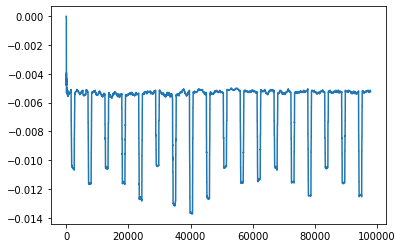

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 20
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 30
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 40
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 300
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 310
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 320
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 330
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 580
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 590
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 600
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 610
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 870
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 880
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 890
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1150
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1160
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1170
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1180


Wrong pnr snap: 43
Action:1
RESET: 1430
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1440
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1450
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1460
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Action:0
Wrong pnr snap: 66
Action:1
RESET: 1710
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1720
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1730
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1740
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2000
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2010
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2020
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2280
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2290
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2300
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Wrong pnr snap: 70
Action:1
RESET: 2560
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2570
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2580
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2590
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2850
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2860
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2870
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3130
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3140
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3150
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3410
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3420
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3430
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RES

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3700
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3710
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3720
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3980
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3990
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4000
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4260
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4270
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4280
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4540
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4550
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4560
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4820
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4830
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4840
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4846
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5100
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5110
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5120
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5130
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0


Action:1
RESET: 5380
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5390
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5400
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5410
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70


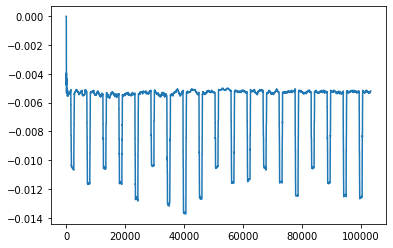

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 17
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 27
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 37
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 47
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 307
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 317
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 327
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 589
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 597
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 607
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 617
Wrong pnr snap: 43
Action:1
RESET: 618
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Ac

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 877
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 887
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 897
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1157
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1167
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1177
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1187


Action:1
RESET: 1437
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1447
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1457
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1467
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1727
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1737
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1747
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2007
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2017
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2027
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2287
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2297
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2307
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2314
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2567
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2575
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2577
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2587
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2857
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2860
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2867
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2877
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3137
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3147
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3157
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3167


Wrong pnr snap: 58
Action:1
RESET: 3417
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3427
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3437
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3447
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3707
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3717
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3727
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3985
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3987
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3997
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4007
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4267
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4277
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4287
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4297


Wrong pnr snap: 58
Action:1
RESET: 4547
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4557
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4567
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4577
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4837
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4847
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4857
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5117
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5127
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5137
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5146
Wrong pnr snap: 58
Action:1
RESET: 5147
Wrong pnr snap: 

Action:0
Wrong pnr snap: 58
Action:1
RESET: 5397
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5407
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5417
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5427
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


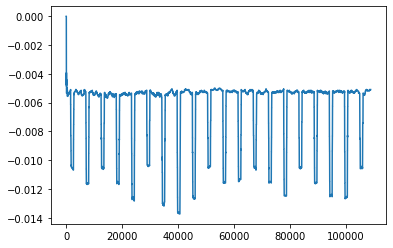

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 24
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 34
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 44
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 304
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 314
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 324
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 584
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 594
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 604
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 864
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 874
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 884
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 894
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1144
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1154
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1164
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1174
Wrong pnr snap: 43


Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1434
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1444
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1453
Wrong pnr snap: 43
Action:1
RESET: 1454
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Wrong pnr snap: 52
Action:0
Wrong pnr snap: 52
Action:0
Wrong pnr snap: 52
Action:0
Wrong pnr snap: 52
Action:0
Wrong pnr snap: 52
Action:0
Wrong pnr snap: 52
Action:0
Wrong pnr snap: 52
Action:0
Wrong pnr snap: 52
Action:0
Wrong pnr snap: 52
Action:1
RESET: 1714
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1724
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1734
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1994
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2004
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2014
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RES

Wrong pnr snap: 57
Action:1
RESET: 2274
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2284
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2294
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2304
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0


Action:0
Wrong pnr snap: 57
Action:1
RESET: 2554
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2564
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2574
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2584
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2844
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2854
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2864
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3124
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3134
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3144
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wro

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3404
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3414
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3424
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wro

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3684
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3694
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3704
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3714
Wrong pnr snap: 57
Action:0


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3974
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3984
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3994
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4254
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4264
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4274
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4534
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4544
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4554
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4558
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4812
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4814
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4824
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4834
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5094
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5104
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5114
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5124
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5384
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5394
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5404
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

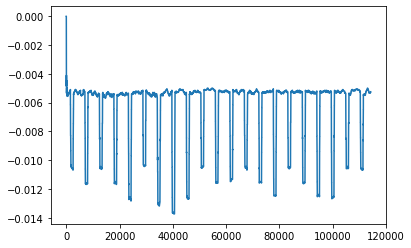

43
Action:1
RESET: 15
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 21
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 31
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 41
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:1
RESET: 301
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 311
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 321
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 331
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 591
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 601
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 611
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 871
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 881
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 891
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1151
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1161
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1171
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1181
Wrong pnr snap: 43


Wrong pnr snap: 43
Action:1
RESET: 1431
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1441
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1451
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1461
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1721
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1731
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1737
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1741
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2001
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2011
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2021
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2281
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2291
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2301
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 64
Action:1
RESET: 2561
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2571
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2581
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2591
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2851
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2861
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2871
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3131
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3141
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3151
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3161


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3411
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3421
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3431
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3441
Wrong pnr snap: 64
Action:0


Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3691
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3701
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3711
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3721
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3971
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3981
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3991
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4001
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4261
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4271
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4281
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4541
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4551
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4561
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4571
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4831
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4841
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4851
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5111
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5121
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5131
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5141


Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5401
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5411
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5421
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

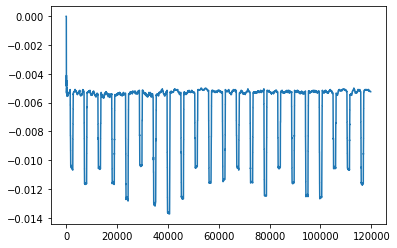

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 18
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 28
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 38
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 42
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 48
Wrong pnr snap

Wrong pnr snap: 43
Action:1
RESET: 298
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 308
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 318
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 328
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 588
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 598
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 608
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 868
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 878
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 888
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 898
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1158
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1168
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1178
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1438
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1448
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1458
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1468
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Wrong pnr snap: 54
Action:1
RESET: 1718
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1728
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1738
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1748
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2008
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2018
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2028
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 55
Action:1
RESET: 2288
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2298
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2308
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2318
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55


Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2578
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2588
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2598
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2858
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2868
Wrong pnr snap: 55
Action:1
RESET: 2869
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2878
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0


Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3138
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3148
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3158
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Wrong pnr snap: 55
Action:1
RESET: 3418
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3428
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3438
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3443
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3448
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 

Wrong pnr snap: 55
Action:1
RESET: 3698
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3708
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3718
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3728
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3988
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3998
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4008
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4268
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4278
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4288
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4298
Wrong pnr snap: 55


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4548
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4558
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4568
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4578
Wrong pnr snap: 55
Action:0


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4838
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4848
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4858
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5118
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5128
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5138
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5398
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5408
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5418
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

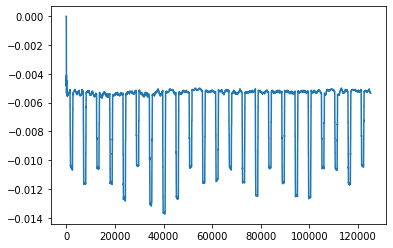

43
Action:1
RESET: 15
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 25
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 35
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 45
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 305
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 315
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 325
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 595
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 605
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 615
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 875
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 885
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 895
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1155
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1165
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1175
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RES

Wrong pnr snap: 43
Action:1
RESET: 1435
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1445
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1455
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1465
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1725
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1735
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1745
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wro

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2005
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2015
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2025
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2285
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2295
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2305
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2575
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2584
Wrong pnr snap: 67
Action:1
RESET: 2585
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2595
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0


Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2855
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2865
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2875
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wro

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3135
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3145
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3155
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3415
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3425
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3435
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3445
Wrong pnr snap: 67


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3695
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3705
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3715
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3725
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3985
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3995
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4005
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4265
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4275
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4285
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wro

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4545
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4555
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4565
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4575


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4825
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4835
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4845
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4855
Wrong pnr snap: 67
Action:0


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5105
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5115
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5125
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5127
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5135
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 

Action:0
Wrong pnr snap: 67
Action:1
RESET: 5385
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5395
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5405
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5415
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


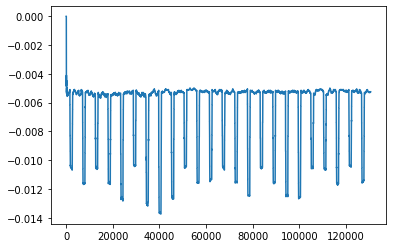

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 22
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 32
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 42
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:1
RESET: 302
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 312
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 322
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 332
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 592
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 602
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 612
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 872
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 882
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 887
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 892
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 902
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 43
Action:1
RESET: 1152
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1162
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1172
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1182
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1442
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1452
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1462
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1722
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1732
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1742
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1751
Wrong pnr snap: 61
Action:1
RESET: 1752
Wrong pnr snap: 

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2002
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2012
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2022
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2032
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Action:1
RESET: 2282
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2286
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2292
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2302
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2312
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong p

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2572
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2582
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2592
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2852
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2862
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2872
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3132
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3142
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3152
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RES

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3412
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3422
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3432
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3442
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:1
RESET: 3692
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3702
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3712
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3722
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3982
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3992
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4002
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4262
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4272
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4282
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4292
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:1
RESET: 4544
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4552
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4562
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4572
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4832
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4842
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4852
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5112
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5122
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5132
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5142


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5392
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5402
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5412
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5422
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


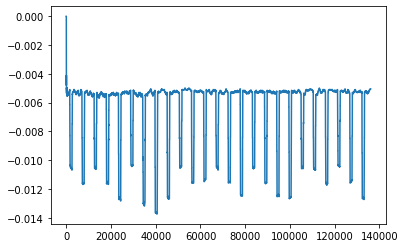

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 19
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 29
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 39
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 309
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 319
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 321
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 329
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 589
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 599
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 609
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 869
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 879
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 889
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 899
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1159
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1169
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1179
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1439
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1449
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1459
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1461
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1719
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1725
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1729
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1739
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1749
Wrong p

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2009
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2019
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2029
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2289
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2299
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2309
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2569
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2579
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2589
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2849
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2859
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2869
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2879
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Action:0
Wrong pnr snap: 61
Action:1
RESET: 3129
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3139
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3149
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3159
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:1
RESET: 3409
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3419
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3429
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3439
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3699
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3709
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3719
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3979
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3989
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3999
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4009
Wrong pnr snap: 61
Action:0


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4269
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4279
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4289
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4292
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4549
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4559
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4569
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4829
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4839
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4849
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5109
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5119
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5129
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5139
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5399
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5409
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5419
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

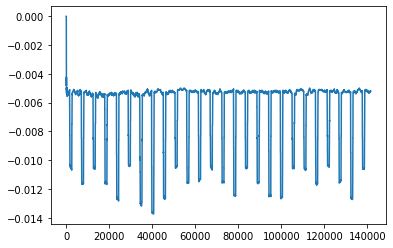

43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 16
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 26
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 36
Wrong pnr snap: 43
Action:1
RESET: 37
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 46
Wrong pnr snap: 43
Action:1
RESET: 47
Wrong pnr snap: 43
Action:0
Wron

Action:1
RESET: 296
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 306
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 316
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 326
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 586
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 596
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 606
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 876
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 886
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 896
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1156
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1166
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1176
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1436
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1446
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1456
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1466
Wrong pnr snap: 43


Action:0
Wrong pnr snap: 60
Action:1
RESET: 1716
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1726
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1736
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1746
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63


Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2006
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2016
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2026
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2286
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2296
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2306
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RES

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2576
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2582
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2586
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2596
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2856
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2866
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2876
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3136
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3146
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3156
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3166
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3426
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3436
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3446
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3706
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3716
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3726
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3986
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3996
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4006
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4016


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4276
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4286
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4296
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4556
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4566
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4576
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4836
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4846
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4856
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4866
Wrong pnr snap: 63


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5126
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5136
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5146
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5406
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5416
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5426
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

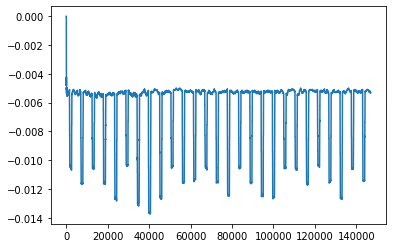

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 23
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 33
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 43
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 303
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 313
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 323
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 333
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 583
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 593
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 603
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 613
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 873
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 879
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 883
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 893
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1153
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1163
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1173
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:1
RESET: 1433
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1443
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1453
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1463
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1723
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1733
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1743
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2003
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2013
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2023
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:1
RESET: 2283
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2288
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2293
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2303
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2313
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong p

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2573
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2583
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2593
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:1
RESET: 2853
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2863
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2873
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2883
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3143
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3153
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3163
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3423
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3433
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3443
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:1
RESET: 3703
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3713
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3723
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3733
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3993
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4003
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4013
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:1
RESET: 4271
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4273
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4283
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4293
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4303
Wrong pnr snap: 

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4553
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4563
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4569
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4573
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4833
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4843
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4853
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4863
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5123
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5130
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5133
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5143
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5403
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5413
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5423
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

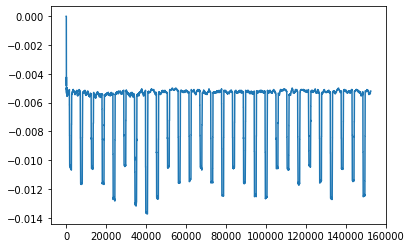

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 20
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 30
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 40
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:1
RESET: 300
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 307
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 310
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 320
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 330
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 590
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 600
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 610
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:1
RESET: 870
Wrong pnr snap: 43
Action:1
RESET: 871
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 880
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 890
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 900
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Ac

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1160
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1170
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1180
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 43
Action:1
RESET: 1440
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1450
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1460
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1470
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1730
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1740
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1750
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2010
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2020
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2030
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2040


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2300
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2310
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2320
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2580
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2590
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2600
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2860
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2870
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2880
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3140
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3150
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3160
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3420
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3430
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3440
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3450
Wrong pnr snap: 70
Action:0


Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3710
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3720
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3730
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3990
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4000
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4010
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4014
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70


Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4270
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4280
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4290
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4550
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4560
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4565
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4570
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4840
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4850
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4860
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5120
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5130
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5140
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5400
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5410
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5420
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5430
Wrong pnr snap: 70
Action:0


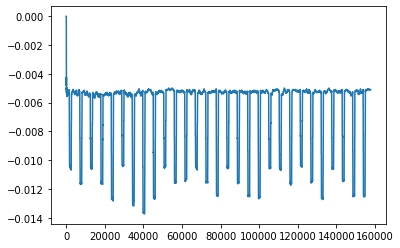

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 17
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 27
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 37
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 47
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 307
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 317
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 327
Wrong pnr snap: 43
Action:1
RESET: 328
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 587
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 597
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 607
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 867
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 877
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 887
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1147
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1157
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1167
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1177
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Action:0
Wrong pnr snap: 43
Action:1
RESET: 1427
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1437
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1447
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1457
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 1717
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1727
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1737
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1997
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2007
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2017
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2027
Wrong pnr snap: 58
Action:0


Action:1
RESET: 2277
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2287
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2297
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2307
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2567
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2577
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2587
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2847
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2857
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2867
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2877
Wrong pnr snap: 58


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3127
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3137
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3147
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3157
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3417
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3427
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3437
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:1
RESET: 3697
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3707
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3717
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3727
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3987
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3997
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4007
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4267
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4277
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4287
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4547
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4557
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4567
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4827
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4837
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4847
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4857
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5117
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5127
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5137
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5397
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5407
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5417
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

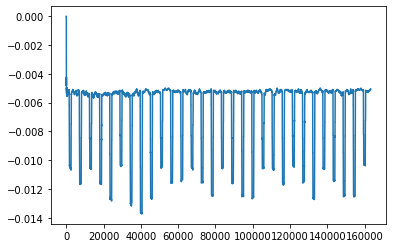

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 24
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 34
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 44
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 304
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 314
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 324
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 584
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 594
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 601
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 604
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 614
Wrong pnr sn

Action:0
Wrong pnr snap: 43
Action:1
RESET: 864
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 874
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 884
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 894
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1154
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1164
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1174
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1434
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1444
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1454
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 52
Action:0
Wrong pnr snap: 52
Action:0
Wrong pnr snap: 52
Action:1
RESET: 1714
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1724
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1734
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1744
Wrong pnr snap: 57


Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2004
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2014
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2024
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wro

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2284
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2294
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2304
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2314


Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2574
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2584
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2594
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wro

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2854
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2864
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2874
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2884
Wrong pnr snap: 57
Action:0


Wrong pnr snap: 57
Action:1
RESET: 3134
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3144
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3154
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3164
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0


Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3424
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3434
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3444
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wro

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3704
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3714
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3724
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3984
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3994
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4004
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RES

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4264
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4274
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4284
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4294
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57


Wrong pnr snap: 57
Action:1
RESET: 4544
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4554
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4564
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4574
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4834
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4844
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4854
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5114
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5124
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5134
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5394
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5404
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5414
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5424


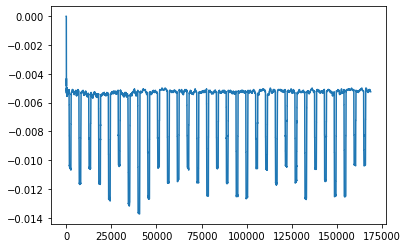

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 21
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 31
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 41
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 311
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 321
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 331
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 591
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 601
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 611
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:1
RESET: 871
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 881
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 891
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 901
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1161
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1171
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1181
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1441
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1451
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1461
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1471


Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1731
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1741
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1751
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2011
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2021
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2031
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2291
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2301
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2311
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2571
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2581
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2591
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2601


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2851
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2861
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2871
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2881
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3141
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3151
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3161
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3421
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3431
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3441
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3701
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3711
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3721
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3981
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3991
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4001
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4011


Action:0
Wrong pnr snap: 64
Action:1
RESET: 4261
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4265
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4271
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4281
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4291
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong p

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4551
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4561
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4571
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4831
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4841
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4851
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4861
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5121
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5131
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5141
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5401
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5411
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5421
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

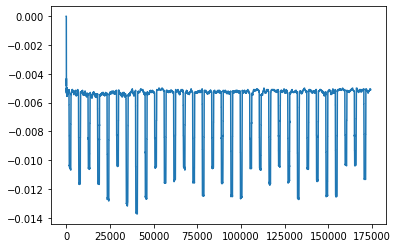

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 18
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 28
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 38
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 48
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 308
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 318
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 328
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 331
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 588
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 598
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 608
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 868
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 878
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 888
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 898
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1158
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1168
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1178
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1438
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1448
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1458
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1718
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 1728
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 1738
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 1748


Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 2008
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 2018
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 2028
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 2288
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 2298
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 2308
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wro

Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 2568
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 2578
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 2588
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 2598
Wrong pnr snap: 56
Action:0


Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 2858
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 2868
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 2878
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wro

Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 3138
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 3148
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 3158
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 3168
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0


Wrong pnr snap: 56
Action:1
RESET: 3418
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 3428
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 3438
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 3448
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0


Action:1
RESET: 3698
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 3708
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 3718
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 3728
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56


Action:1
RESET: 3978
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 3988
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 3998
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 4008
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56


Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 4268
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 4278
Wrong pnr snap: 56
Action:1
RESET: 4279
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 4288
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56


Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 4548
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 4558
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 4568
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 4578
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56


Wrong pnr snap: 56
Action:1
RESET: 4828
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 4838
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 4848
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 4858
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0


Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 5118
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 5128
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 5138
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wro

Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 5398
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 5405
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 5408
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 5418
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 5428
Wrong p

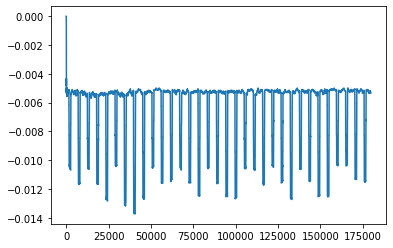

43
Action:1
RESET: 15
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 25
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 35
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 45
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 305
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 315
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 325
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 585
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 595
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 602
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 605
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 865
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 875
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 885
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 895
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1145
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1155
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1165
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1175
Wrong pnr snap: 43
Action:0


Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1435
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1445
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1455
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1715
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1725
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1735
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1745
Wrong pnr snap: 67
Action:0


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2005
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2015
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2025
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2285
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2295
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2305
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2315
Wrong pnr snap: 67


Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2565
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2575
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2585
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2595
Wrong pnr snap: 67


Action:0
Wrong pnr snap: 67
Action:1
RESET: 2845
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2855
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2865
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2875
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Action:0
Wrong pnr snap: 67
Action:1
RESET: 3125
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3135
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3145
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3155
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3415
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3425
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3435
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3695
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3705
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3715
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wro

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3975
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3985
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3995
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4005


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4255
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4265
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4275
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4285
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0


Action:0
Wrong pnr snap: 67
Action:1
RESET: 4535
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4545
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4555
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4565
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4825
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4835
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4845
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wro

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5105
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5115
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5125
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5135
Wrong pnr snap: 67
Action:0


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5395
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5405
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5415
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

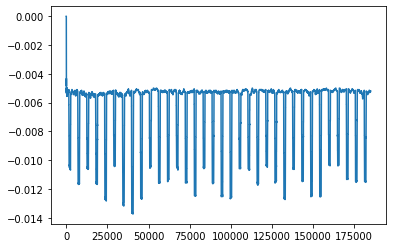

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 22
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 32
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 42
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 45
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 302
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 312
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 322
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 582
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 592
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 602
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 612
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 872
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 882
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 892
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1152
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1162
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1172
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1432
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1442
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1452
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1462
Wrong pnr snap: 43


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1722
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1732
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1742
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2002
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2012
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2022
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2282
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2292
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2302
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2562
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2572
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2582
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2592
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Action:1
RESET: 2842
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2852
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2862
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2872
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3132
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3142
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3152
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3412
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3422
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3432
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3442


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3702
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3712
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3714
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3722
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3982
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3992
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4002
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4262
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4272
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4282
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4542
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4552
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4562
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RES

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4822
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4832
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4842
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4852
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Wrong pnr snap: 61
Action:1
RESET: 5102
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5112
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5122
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5132
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Action:1
RESET: 5382
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5392
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5402
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5412
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


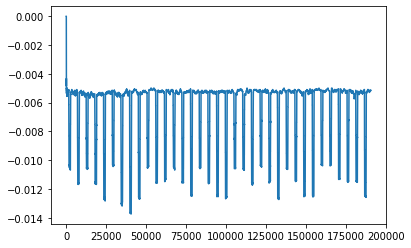

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 19
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 29
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 39
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 309
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 319
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 329
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 589
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 599
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 609
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 619
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 869
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 879
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 889
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 899
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1159
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1169
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1179
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1439
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1449
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1459
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1719
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1726
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1729
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1739
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1749
Wrong p

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2009
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2019
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2029
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2289
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2299
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2309
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:1
RESET: 2569
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2579
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2589
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2598
Wrong pnr snap: 64
Action:1
RESET: 2599
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2859
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2869
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2879
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3139
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3149
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3159
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3169
Wrong pnr snap: 64
Action:0


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3419
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3429
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3439
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3449
Wrong pnr snap: 64
Action:0


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3709
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3719
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3729
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3989
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3999
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4009
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4269
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4279
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4289
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4549
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4559
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4569
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4829
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4839
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4849
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5109
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5119
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5129
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5139


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5395
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5399
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5409
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5419
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


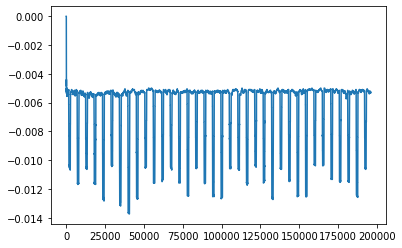

43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 16
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 26
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 36
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 46
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 299
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 306
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 316
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 326
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 586
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 596
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 606
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 876
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 886
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 896
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1156
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1166
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1176
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1436
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1446
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1456
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1466
Wrong pnr snap: 43
Action:0


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1724
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1726
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1736
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1746
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2006
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2016
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2026
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:1
RESET: 2286
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2296
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2306
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2316
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0


Action:1
RESET: 2566
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2576
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2586
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2596
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63


Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2856
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2866
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2876
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Action:0
Wrong pnr snap: 63
Action:1
RESET: 3136
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3146
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3156
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3166
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63


Action:1
RESET: 3416
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3426
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3436
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3446
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63


Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3706
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3716
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3726
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3986
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3996
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4006
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4266
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4274
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4276
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4286
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1


Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4556
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4566
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4576
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4836
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4846
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4856
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4866


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5119
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5126
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5136
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5146
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0


Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5406
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5416
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5426
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

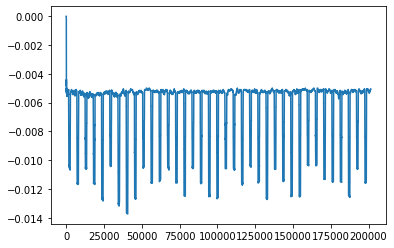

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 23
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 33
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 43
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 303
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 313
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 323
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 333
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:1
RESET: 583
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 593
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 603
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 613
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 873
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 883
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 893
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1153
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1163
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1173
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1183
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Action:0
Wrong pnr snap: 43
Action:1
RESET: 1433
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1443
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1453
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1463
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1723
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1733
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1743
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2003
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2005
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2013
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2023
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Action:0
Wrong pnr snap: 58
Action:1
RESET: 2283
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2293
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2303
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2313
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2573
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2583
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2593
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2853
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2863
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2873
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2880
Wrong pnr snap: 58
Action:0


Action:1
RESET: 3133
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3143
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3153
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3163
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:1
RESET: 3419
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3423
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3433
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3436
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3443
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3703
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3713
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3723
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3733
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3983
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3993
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4003
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4013
Wrong pnr snap: 58
Action:0


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4273
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4283
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4293
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4553
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4563
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4573
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4833
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4843
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4853
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4863
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5123
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5133
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5143
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5403
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5413
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5423
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

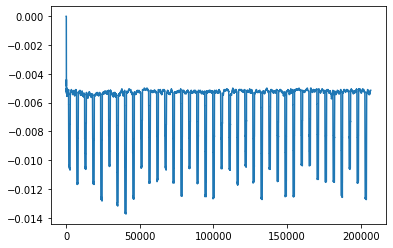

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 20
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 30
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 40
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 310
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 320
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 330
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 590
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 600
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 610
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 620
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 880
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 890
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 900
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1160
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1170
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1180
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RES

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1440
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1450
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1460
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1470
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1730
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1740
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1750
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1755
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2010
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2020
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2030
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2300
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2310
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2320
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2580
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2590
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2600
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2860
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2870
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2880
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2890
Wrong pnr snap: 70
Action:0


Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3150
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3160
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3170
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3430
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3440
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3450
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3460
Wrong pnr snap: 70
Action:0


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3720
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3730
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3740
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4000
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4010
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4020
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4280
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4290
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4300
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4560
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4570
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4580
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4840
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4850
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4860
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5120
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5130
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5140
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5150
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0


Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5410
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5420
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5423
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5430
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70


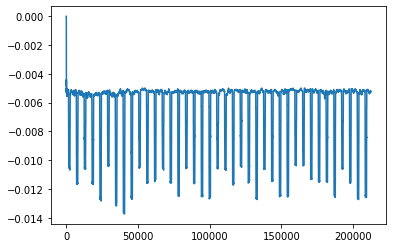

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 17
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 27
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 37
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 47
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 307
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 317
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 327
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:1
RESET: 586
Wrong pnr snap: 43
Action:1
RESET: 587
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 597
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 607
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 615
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 617
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
W

Action:1
RESET: 867
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 877
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 887
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 897
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1157
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1167
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1177
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1437
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1447
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1453
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1457
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1


Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 1717
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1727
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1737
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1747
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2007
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2017
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2027
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:1
RESET: 2287
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2297
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2307
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2317
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2577
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2587
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2597
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2857
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2867
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2869
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2877
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2887
Wrong pnr snap: 58
Action:0
Wrong p

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3137
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3147
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3157
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3167
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3427
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3437
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3447
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3707
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3717
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3727
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3737


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3987
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3997
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4007
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4017
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4277
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4287
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4297
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4557
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4567
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4577
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4837
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4847
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4857
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5117
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5121
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5127
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5137
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5407
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5417
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5427
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

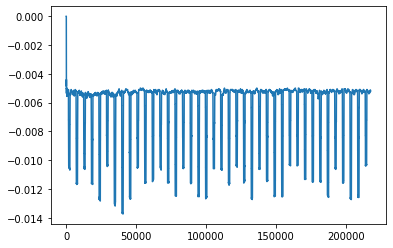

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 24
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 34
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 44
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 304
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 314
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 324
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 584
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 594
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 604
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 614
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 874
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 884
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 894
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1154
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1164
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1174
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1444
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1454
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1464
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1724
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1734
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1744
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RES

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2004
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2014
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2024
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2034
Wrong pnr snap: 57
Action:0


Wrong pnr snap: 57
Action:1
RESET: 2284
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2294
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2304
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2314
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2574
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2584
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2594
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2854
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2864
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2874
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2881
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2884
Wrong pnr snap: 

Action:0
Wrong pnr snap: 57
Action:1
RESET: 3134
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3144
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3154
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3164
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3424
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3434
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3444
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3704
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3714
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3724
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RES

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3994
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4004
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4014
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wro

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4274
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4284
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4294
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4304
Wrong pnr snap: 57


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4564
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4574
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4584
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4844
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4854
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4864
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5124
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5134
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5144
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RES

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5404
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5414
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5424
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5434
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57


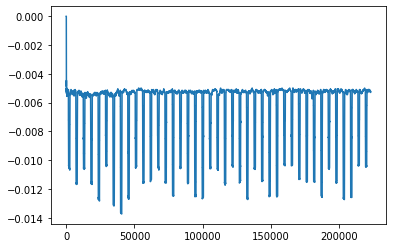

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 21
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 31
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 41
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 301
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 311
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 321
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 331
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 591
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 601
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 611
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 871
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 881
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 891
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1151
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1161
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1171
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1431
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1441
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1451
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1461
Wrong pnr snap: 43
Action:0


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1711
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1721
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1731
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1741
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


Action:1
RESET: 1991
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2001
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2011
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2021
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2281
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2291
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2301
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Action:1
RESET: 2561
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2571
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2581
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2591
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2851
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2861
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2871
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3131
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3141
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3151
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3411
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3421
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3431
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3441


Action:0
Wrong pnr snap: 64
Action:1
RESET: 3691
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3701
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3711
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3721
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3981
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3991
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4001
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4261
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4271
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4281
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4291


Wrong pnr snap: 64
Action:1
RESET: 4541
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4551
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4561
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4571
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4831
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4841
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4851
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5111
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5121
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5131
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5391
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5401
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5411
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RES

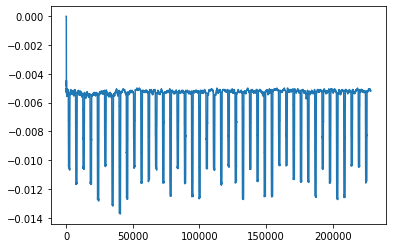

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 18
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 28
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 38
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 48
Wrong pnr snap: 43
Actio

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 308
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 318
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 328
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 588
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 598
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 608
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:1
RESET: 868
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 878
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 888
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 898
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1158
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1168
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1178
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1438
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1448
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1458
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1468
Wrong pnr snap: 43


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1728
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1738
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1748
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2008
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2018
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2028
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2288
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2298
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2308
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2568
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2578
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2588
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2848
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2858
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2868
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2878
Wrong pnr snap: 55
Action:0


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3138
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3148
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3158
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3418
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3428
Wrong pnr snap: 55
Action:1
RESET: 3429
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3438
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3448
Wrong pnr snap: 55
Action:0
Wrong p

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3698
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3708
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3718
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3721
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3728
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3988
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3998
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4008
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4268
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4278
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4288
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4554
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4558
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4568
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4578
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4838
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4848
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4858
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5118
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5128
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5138
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5398
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5408
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5418
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

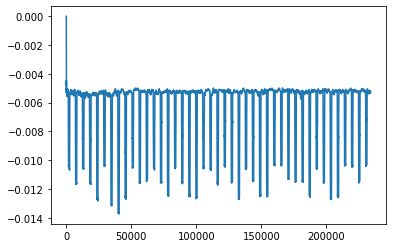

43
Action:1
RESET: 15
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 25
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 35
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 45
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 305
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 315
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 325
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:1
RESET: 585
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 595
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 605
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 615
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 875
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 885
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 895
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1155
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1165
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1175
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1435
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1445
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1455
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1465
Wrong pnr snap: 43
Action:0


Wrong pnr snap: 63
Action:1
RESET: 1715
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1725
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1735
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1745
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2005
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2015
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2025
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2285
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2295
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2301
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2305
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2565
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2575
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2585
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2595
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2855
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2865
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2875
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wro

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3135
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3145
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3155
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wro

Action:0
Wrong pnr snap: 67
Action:1
RESET: 3415
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3425
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3435
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3445
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3705
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3715
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3725
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3985
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3995
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4005
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4015


Wrong pnr snap: 67
Action:1
RESET: 4265
Wrong pnr snap: 67
Action:1
RESET: 4266
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4275
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4285
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4295
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4555
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4565
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4575
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4835
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4845
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4855
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wro

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5115
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5125
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5135
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5395
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5405
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5415
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

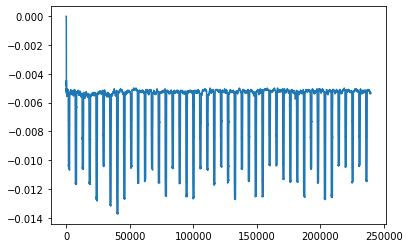

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 22
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 32
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 42
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 302
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 312
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 322
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 332
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 592
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 602
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 612
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 882
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 884
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 892
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 895
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 902
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1162
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1172
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1182
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1442
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1452
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1462
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1472
Wrong pnr snap: 43


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1732
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1742
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1752
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2012
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2022
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2032
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2292
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2302
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2312
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2322
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Wrong pnr snap: 61
Action:1
RESET: 2572
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2582
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2592
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2602
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2862
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2864
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2872
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2882
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3142
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3152
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3162
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3172
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3422
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3432
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3442
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3452
Wrong pnr snap: 61
Action:0


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3712
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3722
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3732
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3992
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4002
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4012
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4022
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:1
RESET: 4272
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4282
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4292
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4302
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4562
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4572
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4582
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4842
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4852
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4862
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4872
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:1
RESET: 5122
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5132
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5142
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5152
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5412
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5422
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5432
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

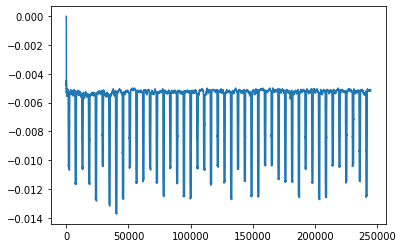

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 19
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 29
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 39
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Wrong pnr snap: 43
Action:1
RESET: 299
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 309
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 319
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 329
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 589
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 599
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 609
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 869
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 879
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 889
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 899
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:1
RESET: 1149
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1159
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1169
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1179
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Action:1
RESET: 1429
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1433
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1439
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1449
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1459
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong p

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1719
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1729
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1739
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1999
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2009
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2019
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2279
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2289
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2299
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2309
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Wrong pnr snap: 61
Action:1
RESET: 2559
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2569
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2579
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2589
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Action:1
RESET: 2839
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2842
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2849
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2859
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2869
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong p

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3129
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3134
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3139
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3149
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3419
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3429
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3439
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3699
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3709
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3719
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3979
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3989
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3999
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4009
Wrong pnr snap: 61
Action:0


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4269
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4279
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4289
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4549
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4559
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4569
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4579


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4839
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4849
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4859
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5119
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5129
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5139
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5399
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5409
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5419
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5429
Wrong pnr snap: 61


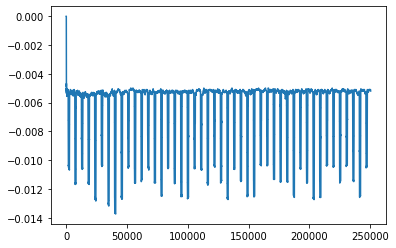

43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 16
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 26
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 36
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 46
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 306
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 316
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 326
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 586
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 596
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 606
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 866
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 876
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 886
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:1
RESET: 1146
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1156
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1166
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1176
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1436
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1446
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1456
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 60
Action:0
Wrong pnr snap: 60
Action:0
Wrong pnr snap: 60
Action:0
Wrong pnr snap: 60
Action:1
RESET: 1716
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1726
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1736
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1746


Action:1
RESET: 1996
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2006
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2016
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2026
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63


Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2286
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2296
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2306
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2566
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2576
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2586
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RES

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2846
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2856
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2866
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2876
Wrong pnr snap: 63
Action:0


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3136
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3146
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3156
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3416
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3426
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3436
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:1
RESET: 3696
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3706
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3716
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3726
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0


Wrong pnr snap: 63
Action:1
RESET: 3976
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3986
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3996
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4006
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0


Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4266
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4276
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4286
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4554
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4556
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4566
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4569
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4576
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4836
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4846
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4856
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Action:0
Wrong pnr snap: 63
Action:1
RESET: 5116
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5126
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5136
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5146
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63


Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5406
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5416
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5426
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

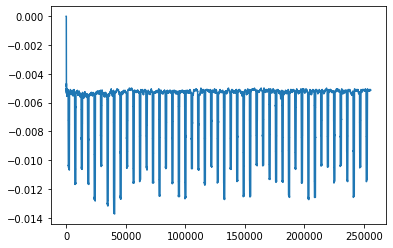

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 23
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 33
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 43
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:1
RESET: 303
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 313
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 323
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 333
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 593
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 603
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 613
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 873
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 883
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 893
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 903
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1153
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1163
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1173
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1183
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1443
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1453
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1463
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1723
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1733
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1743
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2003
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2013
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2023
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2033
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2293
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2303
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2313
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2573
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2583
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2593
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2853
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2863
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2873
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2883
Wrong pnr snap: 58
Action:0


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3143
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3153
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3161
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3163
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3423
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3433
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3443
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:1
RESET: 3703
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3713
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3723
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3733
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3993
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4003
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4013
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4273
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4283
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4293
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:1
RESET: 4553
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4563
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4573
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4583
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4843
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4853
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4863
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5123
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5133
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5143
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5403
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5413
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5423
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

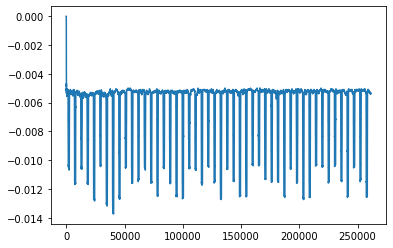

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 20
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 30
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 40
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 300
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 310
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 320
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 330
Wron

Action:0
Wrong pnr snap: 43
Action:1
RESET: 580
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 590
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 600
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 610
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 870
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 880
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 890
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:1
RESET: 1150
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1160
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1170
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1180
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1440
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1450
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1460
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1720
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1730
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1740
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1750


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2000
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2010
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2020
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2030
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0


Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2290
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2300
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2310
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2570
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2580
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2590
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2600
Wrong pnr snap: 70


Wrong pnr snap: 70
Action:1
RESET: 2850
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2860
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2870
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2880
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3140
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3150
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3160
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3420
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3430
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3440
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:1
RESET: 3700
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3703
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3710
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3720
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3730
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 

Action:0
Wrong pnr snap: 70
Action:1
RESET: 3980
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3990
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4000
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4010
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4270
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4280
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4290
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4550
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4560
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4570
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4830
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4840
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4850
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5110
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5120
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5130
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5136
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5140
Wrong p

Wrong pnr snap: 70
Action:1
RESET: 5390
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5400
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5410
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5420
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0


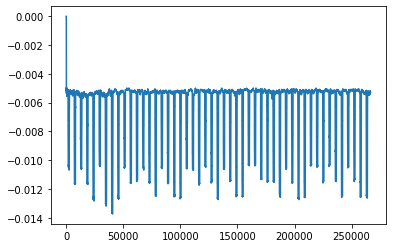

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 17
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 27
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 37
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 47
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 307
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 317
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 327
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 587
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 597
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 607
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 617
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 877
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 887
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 897
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1157
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1167
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1177
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1187
Wrong pnr snap: 43
Action:0


Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1447
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1457
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1467
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1727
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1737
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1747
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2007
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2017
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2027
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RES

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2287
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2297
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2307
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2317


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2567
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2577
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2587
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2589
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2597
Wrong pnr snap: 

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2857
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2867
Wrong pnr snap: 58
Action:1
RESET: 2868
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2877
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3137
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3147
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3157
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3417
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3427
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3436
Wrong pnr snap: 58
Action:1
RESET: 3437
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3697
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3707
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3717
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3727
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3987
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3997
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4007
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4267
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4277
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4287
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4547
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4557
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4567
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4827
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4837
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4847
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4853
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5107
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5111
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5117
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5127
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5137
Wrong pnr snap: 

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5397
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5407
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5417
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

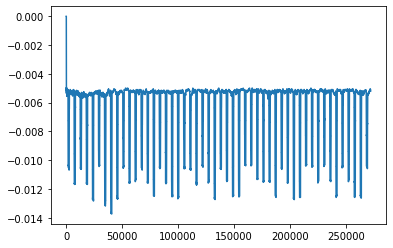

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 24
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 34
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 44
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 304
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 314
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 324
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 334
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:1
RESET: 584
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 594
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 604
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 614
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 874
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 879
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 884
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 894
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1154
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1164
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1174
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1184


Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1444
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1454
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1464
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1724
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1734
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1744
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wro

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2004
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2014
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2024
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2284
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2294
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2304
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2314
Wrong pnr snap: 57
Action:0


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2574
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2584
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2594
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2854
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2864
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2874
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wro

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3134
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3144
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3154
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3164


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3424
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3434
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3444
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3704
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3714
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3724
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wro

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3984
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3994
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4004
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4014


Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4264
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4274
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4284
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4294
Wrong pnr snap: 57


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4554
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4564
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4574
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4834
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4844
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4854
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5114
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5124
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5134
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5144
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0


Action:0
Wrong pnr snap: 57
Action:1
RESET: 5394
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5404
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5414
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5424
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57


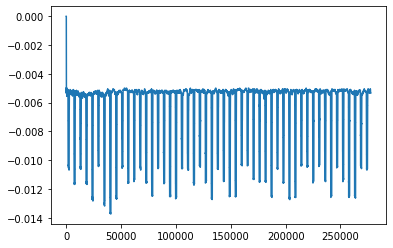

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 21
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 31
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 41
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 44
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 301
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 311
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 321
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 581
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 591
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 601
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 611
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:1
RESET: 861
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 871
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 881
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 891
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1151
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1161
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1171
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1431
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1441
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1451
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1461


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1721
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1731
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1741
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2001
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2011
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2021
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2281
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2291
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2301
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2561
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2571
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2581
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2591


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2851
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2861
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2871
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3131
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3141
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3151
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3411
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3421
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3431
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3691
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3701
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3711
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RES

Action:0
Wrong pnr snap: 64
Action:1
RESET: 3971
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3981
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3991
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4001
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4261
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4271
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4281
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4541
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4551
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4561
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RES

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4821
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4831
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4841
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4846
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4851
Wrong p

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5111
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5121
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5131
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5391
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5401
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5411
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

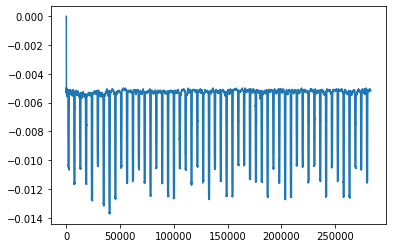

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 18
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 28
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 38
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 48
Wrong pnr snap: 43
Actio

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 308
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 318
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 328
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 588
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 598
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 608
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 868
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 878
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 888
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1148
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1158
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1168
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1178
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1438
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1448
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1458
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 54
Action:0
Wrong pnr snap: 54
Action:0
Wrong pnr snap: 54
Action:0
Wrong pnr snap: 54
Action:0
Wrong pnr snap: 54
Action:1
RESET: 1718
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1728
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1738
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1998
Wrong pnr snap: 55
Action:1
RESET: 1999
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2008
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2018
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2028
Wrong p

Action:0
Wrong pnr snap: 55
Action:1
RESET: 2278
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2288
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2298
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2308
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55


Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2568
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2578
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2588
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2848
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2858
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2868
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2878


Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3138
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3148
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3158
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3418
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3428
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3438
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3698
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3708
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3718
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RES

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3978
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3988
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3998
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4008


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4268
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4278
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4288
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4548
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4558
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4568
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4828
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4838
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4848
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 55
Action:1
RESET: 5108
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5118
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5128
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5138
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55


Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5398
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5408
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5418
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

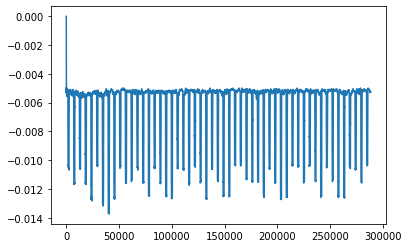

43
Action:1
RESET: 15
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 25
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 35
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 45
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 305
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 315
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 325
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 585
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 595
Wrong pnr snap: 43
Action:1
RESET: 596
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 605
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESE

Action:1
RESET: 865
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 875
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 885
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 895
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1155
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1165
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1175
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1181
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1435
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1445
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1455
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1465


Action:0
Wrong pnr snap: 63
Action:1
RESET: 1715
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1725
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1735
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1745
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2005
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2015
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2025
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2285
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2295
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2305
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wro

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2565
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2575
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2585
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2595
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2855
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2865
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2868
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2875
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3135
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3145
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3155
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3165
Wrong pnr snap: 67
Action:0


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3425
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3435
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3445
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3705
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3715
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3725
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3985
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3995
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4005
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4010
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4015
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4265
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4275
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4285
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4295
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4555
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4565
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4575
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4835
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4845
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4855
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:1
RESET: 5115
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5125
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5135
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5145
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5405
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5415
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5425
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wro

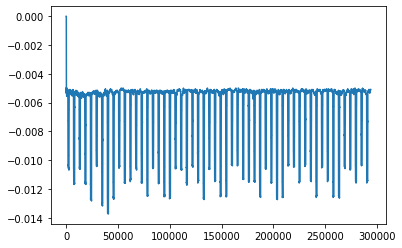

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 22
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 32
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 42
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 302
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 312
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 321
Wrong pnr snap: 43
Action:1
RESET: 322
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 332
Wrong pnr snap: 43
Ac

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 592
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 602
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 612
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 872
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 882
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 892
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 902
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1162
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1172
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1182
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1442
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1452
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1462
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1470
Wrong pnr snap: 43


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1722
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1732
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1742
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2002
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2012
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2022
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2032
Wrong pnr snap: 61
Action:0


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2292
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2302
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2312
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2572
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2582
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2592
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2852
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2862
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2872
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2882
Wrong pnr snap: 61
Action:0


Action:0
Wrong pnr snap: 61
Action:1
RESET: 3132
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3142
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3152
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3159
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3162
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong p

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3422
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3432
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3442
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3702
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3712
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3722
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 61
Action:1
RESET: 3982
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3992
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4002
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4012
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4272
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4282
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4292
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4552
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4562
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4572
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4832
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4842
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4852
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5112
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5122
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5132
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5142


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5402
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5412
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5422
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

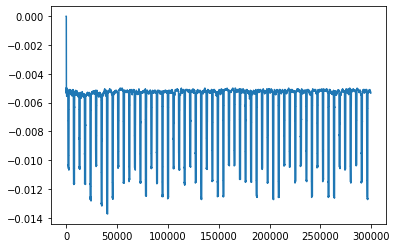

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 19
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 29
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 39
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 309
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 317
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 319
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 329
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 589
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 599
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 609
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 619
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 879
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 889
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 899
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1159
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1169
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1179
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1439
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1449
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1459
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1469


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1719
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1729
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1739
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1749
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1999
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2009
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2019
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2029
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Action:1
RESET: 2279
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2289
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2299
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2309
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2569
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2579
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2589
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2849
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2859
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2869
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3129
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3139
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3149
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3159
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3419
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3429
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3439
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3699
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3709
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3719
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3729
Wrong pnr snap: 61
Action:0


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3989
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3993
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3999
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4009
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4269
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4279
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4289
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4549
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4557
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4559
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4569
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4829
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4839
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4849
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4859
Wrong pnr snap: 61
Action:0


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5109
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5119
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5129
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5139
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5399
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5409
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5419
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

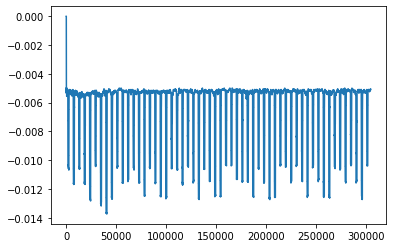

43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 16
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 26
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 36
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 46
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:1
RESET: 302
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 306
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 316
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 326
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 596
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 606
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 616
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 876
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 886
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 896
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 906
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1166
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1176
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1186
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1446
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1456
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1466
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RES

Action:1
RESET: 1726
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1736
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1746
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1756
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2016
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2026
Wrong pnr snap: 63
Action:1
RESET: 2027
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2036
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2296
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2306
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2316
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2576
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2586
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2596
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2606


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2861
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2866
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2876
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2886
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0


Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3146
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3156
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3166
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3425
Wrong pnr snap: 63
Action:1
RESET: 3426
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3436
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3446
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1


Wrong pnr snap: 63
Action:1
RESET: 3706
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3709
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3716
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3726
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3736
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3996
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4006
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4016
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4276
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4286
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4296
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4556
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4566
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4576
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:1
RESET: 4836
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4846
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4856
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4866
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5126
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5136
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5146
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5406
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5416
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5426
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

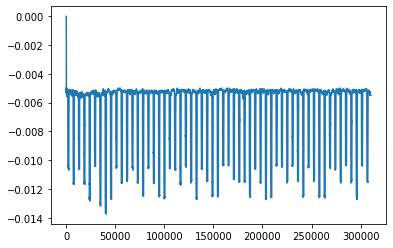

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 23
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 33
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 43
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 303
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 313
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 323
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 333
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 593
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 603
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 613
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 873
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 883
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 893
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1153
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1157
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1163
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1173
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1183
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1443
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1453
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1463
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1723
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1730
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1733
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1743
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:1
RESET: 2003
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2013
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2023
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2033
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2293
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2303
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2313
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2573
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2583
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2593
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2853
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2863
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2873
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3133
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3137
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3143
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3153
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3163
Wrong pnr snap: 58
Action:1
RESET: 

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3423
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3433
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3443
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3703
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3713
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3723
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3729
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3733
Wrong pnr snap: 

Action:1
RESET: 3983
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3993
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4003
Wrong pnr snap: 58
Action:1
RESET: 4004
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4013
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong p

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4273
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4283
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4293
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4553
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4563
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4573
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RES

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4833
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4838
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4843
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4853
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5113
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5123
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5133
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5143
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5403
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5413
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5423
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

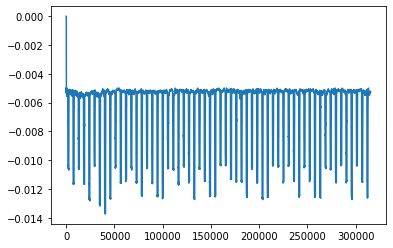

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 20
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 30
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 40
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 300
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 310
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 320
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 330
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 590
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 600
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 610
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:1
RESET: 870
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 876
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 880
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 886
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 890
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 900
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1160
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1170
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1180
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1440
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1450
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1460
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1720
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1730
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1740
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1750


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2000
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2010
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2020
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2030
Wrong pnr snap: 70
Action:0


Action:1
RESET: 2280
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2290
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2300
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2310
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2570
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2580
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2590
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 70
Action:1
RESET: 2850
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2860
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2870
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2880
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3140
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3150
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3160
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3420
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3430
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3440
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3700
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3710
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3720
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3980
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3990
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4000
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4010
Wrong pnr snap: 70


Action:0
Wrong pnr snap: 70
Action:1
RESET: 4260
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4270
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4280
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4290
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70


Wrong pnr snap: 70
Action:1
RESET: 4540
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4550
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4560
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4570
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0


Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4830
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4840
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4850
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5110
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5120
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5130
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RES

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5400
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5410
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5420
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

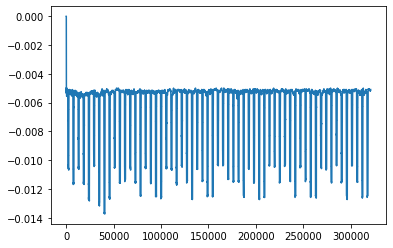

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 17
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 23
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 27
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 37
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 46
Wrong pnr snap: 43
Action:1
RESET: 47
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:1
RESET: 297
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 307
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 317
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 327
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 587
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 597
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 607
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 867
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 877
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 886
Wrong pnr snap: 43
Action:1
RESET: 887
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 897
Wrong pnr sn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1147
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1157
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1167
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1177
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1437
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1447
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1457
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:0
Wrong pnr snap: 56
Action:1
RESET: 1717
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1727
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1737
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1747
Wrong pnr snap: 58
Action:0


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2007
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2017
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2027
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2287
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2297
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2307
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:1
RESET: 2567
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2577
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2587
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2592
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2597
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong p

Action:1
RESET: 2847
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2857
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2867
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2877
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3137
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3147
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3157
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:1
RESET: 3417
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3427
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3437
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3447
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3707
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3717
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3727
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3987
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3997
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4007
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4017


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4267
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4277
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4287
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4293
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4297
Wrong pnr snap: 58
Action:0
Wrong p

Wrong pnr snap: 58
Action:1
RESET: 4547
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4557
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4567
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4577
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4837
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4847
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4857
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5117
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5127
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5137
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5397
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5407
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5417
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

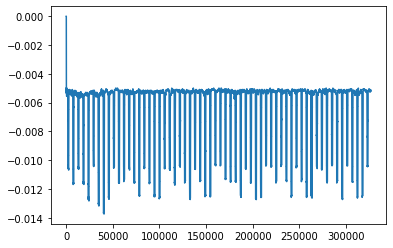

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 24
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 34
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 44
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 304
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 314
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 324
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 584
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 594
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 604
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 864
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 874
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 884
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 894
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1154
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1164
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1166
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1174
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1434
Wrong pnr snap: 43
Action:1
RESET: 1435
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1444
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1454
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1464
Wrong pnr snap: 

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1724
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1734
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1744
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2004
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2014
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2024
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2034
Wrong pnr snap: 57
Action:0


Action:1
RESET: 2284
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2294
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2304
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2314
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2574
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2584
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2594
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Wrong pnr snap: 57
Action:1
RESET: 2854
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2864
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2874
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2884
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0


Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3144
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3154
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3164
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wro

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3424
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3434
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3444
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3454
Wrong pnr snap: 57


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3704
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3714
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3724
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3734
Wrong pnr snap: 57
Action:0


Action:0
Wrong pnr snap: 57
Action:1
RESET: 3984
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3994
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4004
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4014
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4274
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4284
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4294
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4554
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4564
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4574
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4834
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4844
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4854
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4864
Wrong pnr snap: 57
Action:0


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5124
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5134
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5144
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5404
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5414
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5424
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5434


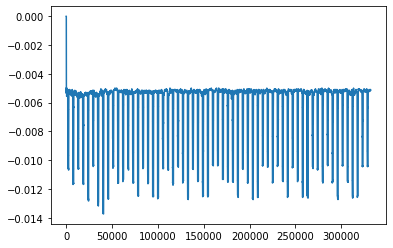

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 21
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 31
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 41
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 301
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 311
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 321
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 331
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 591
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 601
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 611
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 871
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 881
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 891
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 901
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1161
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1171
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1181
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1441
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1451
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1457
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1461
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Action:1
RESET: 1721
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1731
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1741
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1751
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2011
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2021
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2031
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RES

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2291
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2301
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2311
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RES

Wrong pnr snap: 64
Action:1
RESET: 2571
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2581
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2591
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2601
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2861
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2871
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2881
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:1
RESET: 3135
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3141
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3151
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3161
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3421
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3431
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3439
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3441
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


Action:1
RESET: 3701
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3711
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3721
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3731
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3991
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4001
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4011
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4271
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4281
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4291
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Action:1
RESET: 4551
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4561
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4571
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4581
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4841
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4851
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4861
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5121
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5131
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5141
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5401
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5404
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5411
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5421
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


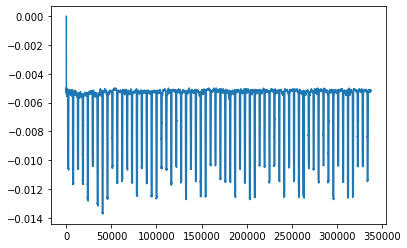

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 18
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 28
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 38
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 48
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 308
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 318
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 328
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 588
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 598
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 608
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 618
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 868
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 878
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 888
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 898
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:1
RESET: 1148
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1158
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1168
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1178
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1438
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1448
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1458
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 54
Action:0
Wrong pnr snap: 54
Action:0
Wrong pnr snap: 54
Action:1
RESET: 1718
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1728
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1738
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1748
Wrong pnr snap: 55
Action:0


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2008
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2018
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2028
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2288
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2298
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2308
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2318


Action:0
Wrong pnr snap: 55
Action:1
RESET: 2568
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2578
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2588
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2598
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55


Action:1
RESET: 2848
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2858
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2868
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2878
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55


Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3138
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3148
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3158
Wrong pnr snap: 55
Action:1
RESET: 3159
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3418
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3428
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3438
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3698
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3708
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3718
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3978
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3988
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3998
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4008
Wrong pnr snap: 55


Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4268
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4278
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4288
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4548
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4558
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4568
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4828
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4838
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4848
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4858
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5118
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5128
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5138
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5398
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5408
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5418
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

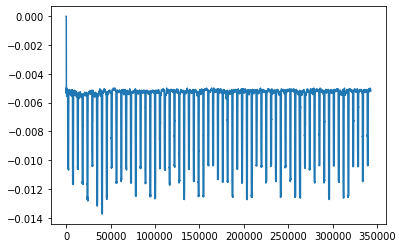

43
Action:1
RESET: 15
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 25
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 35
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 45
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 305
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 315
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 325
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 585
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 595
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 605
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 615
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 875
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 885
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 895
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:1
RESET: 1155
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1165
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1175
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1185
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1445
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1455
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1465
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1725
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1735
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1745
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wro

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2005
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2015
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2025
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2035
Wrong pnr snap: 67
Action:0


Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2285
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2295
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2305
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2315
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2575
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2585
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2595
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2855
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2859
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2865
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2875
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3135
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3145
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3155
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3165
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0


Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3425
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3435
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3445
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wro

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3705
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3715
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3725
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3985
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3995
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4005
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4015
Wrong pnr snap: 67
Action:0


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4275
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4285
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4295
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4555
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4565
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4575
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:1
RESET: 4835
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4845
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4855
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4865
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5125
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5135
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5145
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5405
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5415
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5425
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wro

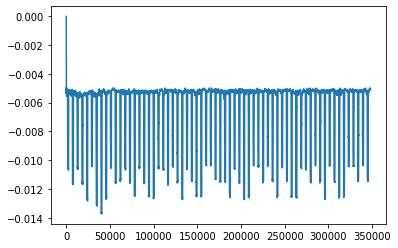

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 22
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 32
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 42
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:1
RESET: 302
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 309
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 312
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 322
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 332
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Ac

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 592
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 602
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 612
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 872
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 882
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 890
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 892
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 902
Wrong pnr snap: 43
Ac

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1162
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1172
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1182
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1442
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1452
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1462
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1722
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1732
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1742
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:1
RESET: 2002
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2012
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2022
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2032
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2292
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2302
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2312
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2572
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2582
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2592
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2602


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2852
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2862
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2871
Wrong pnr snap: 61
Action:1
RESET: 2872
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2882
Wrong pnr snap: 

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3132
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3142
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3152
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3162
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3412
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3422
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3432
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3442
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3702
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3712
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3722
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3982
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3992
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4002
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 61
Action:1
RESET: 4262
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4272
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4282
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4292
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4552
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4562
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4572
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4832
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4842
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4852
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5112
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5122
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5132
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5136
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5392
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5402
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5412
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5422
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


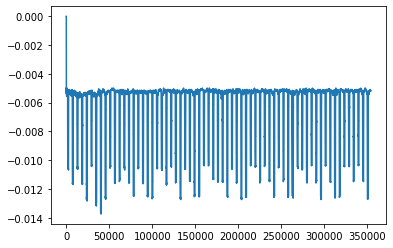

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 19
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 29
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 39
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 299
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 309
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 319
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 329
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Action:1
RESET: 579
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 589
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 599
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 609
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 869
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 876
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 879
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 889
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1149
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1159
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1169
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1179
Wrong pnr snap: 43


Action:1
RESET: 1429
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1439
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1449
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1453
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1459
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong p

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1719
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1729
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1739
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1999
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2009
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2019
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2278
Wrong pnr snap: 61
Action:1
RESET: 2279
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2289
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2299
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2559
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2569
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2579
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2589
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:1
RESET: 2839
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2841
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2849
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2859
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2869
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3129
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3139
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3141
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3149
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Action:0
Wrong pnr snap: 61
Action:1
RESET: 3409
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3419
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3429
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3439
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3699
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3709
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3719
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3979
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3989
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3999
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Wrong pnr snap: 61
Action:1
RESET: 4259
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4269
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4279
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4289
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4549
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4559
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4569
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4829
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4839
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4849
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5109
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5119
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5129
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5139
Wrong pnr snap: 61


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5399
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5409
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5419
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

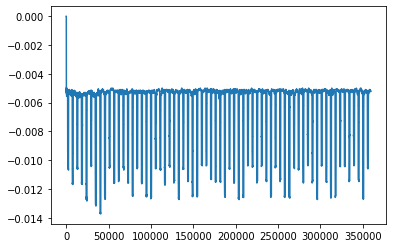

43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 16
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 26
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 36
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 46
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 306
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 316
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 326
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:1
RESET: 586
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 596
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 606
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 616
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 876
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 886
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 896
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1166
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1176
Wrong pnr snap: 43
Action:1
RESET: 1177
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1186
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1446
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1456
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1466
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1726
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1736
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1746
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2006
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2016
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2026
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2286
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2296
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2306
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2316
Wrong pnr snap: 63
Action:0


Wrong pnr snap: 63
Action:1
RESET: 2566
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2576
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2586
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2596
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0


Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2856
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2866
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2876
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3136
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3146
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3156
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Action:0
Wrong pnr snap: 63
Action:1
RESET: 3416
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3426
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3436
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3446
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3706
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3716
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3726
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3986
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 3996
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4006
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4015
Wrong pnr snap: 63


Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4266
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4276
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4282
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4286
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63


Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4546
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4556
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4566
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4576
Wrong pnr snap: 63


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4826
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4828
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4836
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4846
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4848
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 4856
Wrong pnr snap: 63
Action:0
Wron

Action:0
Wrong pnr snap: 63
Action:1
RESET: 5106
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5116
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5126
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5136
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63


Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5396
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5406
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 5416
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr sn

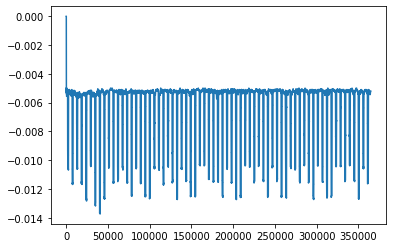

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 23
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 33
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 43
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:1
RESET: 303
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 313
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 317
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 323
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 333
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 593
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 603
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 613
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:1
RESET: 873
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 883
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 893
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 903
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1163
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1173
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1183
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1443
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1453
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1463
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1473


Action:0
Wrong pnr snap: 62
Action:1
RESET: 1723
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 1733
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 1743
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 1753
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62


Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 2013
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 2023
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 2033
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wro

Action:1
RESET: 2293
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 2303
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 2313
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 2323
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62


Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 2583
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 2593
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 2603
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wro

Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 2863
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 2873
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 2883
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wro

Action:1
RESET: 3143
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 3153
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 3163
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 3173
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62


Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 3433
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 3443
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 3453
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr sn

Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 3713
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 3723
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 3733
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 3743
Wrong pnr snap: 62
Action:0


Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 3993
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 4000
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 4003
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 4013
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 4023
Wrong pnr snap: 62
Action:0
Wrong p

Action:1
RESET: 4273
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 4283
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 4293
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 4303
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62


Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 4563
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 4573
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 4583
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wro

Action:0
Wrong pnr snap: 62
Action:1
RESET: 4843
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 4853
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 4863
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 4873
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62


Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 5133
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 5143
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 5153
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 5413
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 5423
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:1
RESET: 5433
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wrong pnr snap: 62
Action:0
Wro

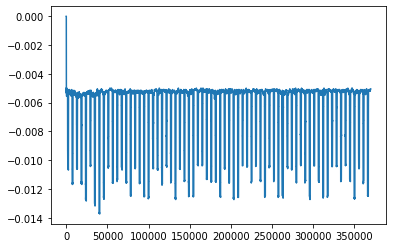

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 20
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 30
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 40
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:1
RESET: 300
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 310
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 320
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 330
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 590
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 600
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 610
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 870
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 880
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 890
Wrong pnr snap: 43
Action:1
RESET: 891
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1150
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1160
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1170
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1180
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1440
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1450
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1460
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1720
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1730
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 1740
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2000
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2010
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2020
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2280
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2290
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2300
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2310
Wrong pnr snap: 70
Action:0


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2560
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2570
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2580
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2590
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2850
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2860
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 2870
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3130
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3140
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3150
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3410
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3420
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3430
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3440


Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3690
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3700
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3710
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3720
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70


Wrong pnr snap: 70
Action:1
RESET: 3970
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3980
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 3990
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4000
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0


Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4260
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4270
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4280
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wro

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4540
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4550
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4560
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4820
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4830
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 4840
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr sn

Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5100
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5110
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5120
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5130


Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5380
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5390
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5400
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5405
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:0
Wrong pnr snap: 70
Action:1
RESET: 5410
Wrong pnr snap: 

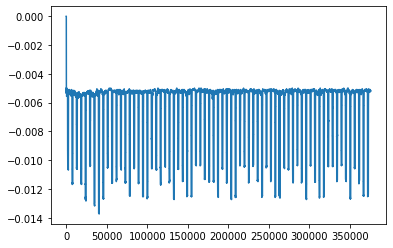

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 17
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 27
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 37
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 47
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 307
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 317
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 327
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 587
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 597
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 607
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 617
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:1
RESET: 867
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 877
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 887
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 897
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1157
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1167
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1177
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1437
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1447
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1457
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RES

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1727
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1737
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 1747
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2007
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2017
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2027
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2037


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2297
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2302
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2307
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2317
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2577
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2587
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2597
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2857
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2867
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 2877
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RES

Action:1
RESET: 3137
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3147
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3157
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3167
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3427
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3437
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3447
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wro

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3707
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3717
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3727
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3737
Wrong pnr snap: 58
Action:0


Action:1
RESET: 3987
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 3997
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4007
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4017
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Action:1
RESET: 4267
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4277
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4287
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4297
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4557
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4567
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4577
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr sn

Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4837
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4847
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4857
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 4867


Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5117
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5127
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5137
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5147
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0


Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5397
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5407
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5417
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58
Action:1
RESET: 5427
Wrong pnr snap: 58
Action:0
Wrong pnr snap: 58


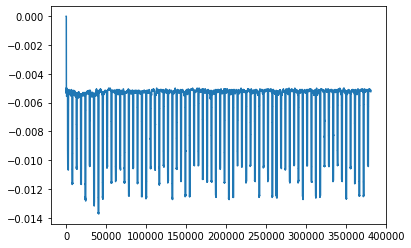

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 24
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 34
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 44
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 304
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 314
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 324
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Action:0
Wrong pnr snap: 43
Action:1
RESET: 584
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 594
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 604
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 614
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 874
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 884
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 894
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:1
RESET: 1154
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1164
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1174
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1184
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Wrong pnr snap: 43
Action:1
RESET: 1434
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1444
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1454
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1464
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1724
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1734
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 1744
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 57
Action:1
RESET: 2004
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2014
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2024
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2034
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2291
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2294
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2304
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2314
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0


Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2574
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2584
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2594
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wro

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2854
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2864
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2874
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 2884
Wrong pnr snap: 57


Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3144
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3154
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3164
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wro

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3424
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3434
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3444
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RES

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3704
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3714
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3724
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3734


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 3994
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4004
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4014
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4274
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4284
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4294
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RES

Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4554
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4564
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4574
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4584


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4834
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4844
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4854
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 4864
Wrong pnr snap: 57
Action:0


Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5114
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5124
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5134
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5144
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0


Wrong pnr snap: 57
Action:1
RESET: 5394
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5404
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5414
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:1
RESET: 5424
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0
Wrong pnr snap: 57
Action:0


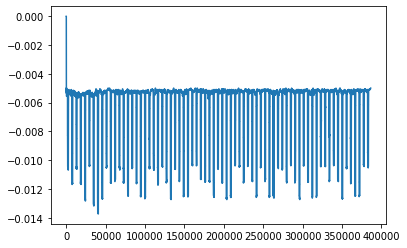

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 21
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 31
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 41
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 301
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 311
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 321
Wrong pnr snap: 43
Action:1
RESET: 322
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 331
Wrong pnr sn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 591
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 601
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 611
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 871
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 881
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 891
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1151
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1161
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1171
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1431
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1441
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1451
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1461


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1711
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1721
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1731
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1741
Wrong pnr snap: 64
Action:0


Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 1991
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2001
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2011
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2021
Wrong pnr snap: 64


Action:0
Wrong pnr snap: 64
Action:1
RESET: 2271
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2281
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2291
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2301
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Action:0
Wrong pnr snap: 64
Action:1
RESET: 2551
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2561
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2571
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2581
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2841
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2851
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 2861
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3121
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3131
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3141
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3151
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3411
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3421
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3431
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr sn

Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3691
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3701
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3708
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3711
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3971
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3981
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 3991
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RES

Action:1
RESET: 4251
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4261
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4271
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4281
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64


Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4541
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4551
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4561
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4821
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4831
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 4841
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wro

Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5101
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5111
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5121
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5131
Wrong pnr snap: 64


Wrong pnr snap: 64
Action:1
RESET: 5381
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5391
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5401
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:1
RESET: 5411
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0
Wrong pnr snap: 64
Action:0


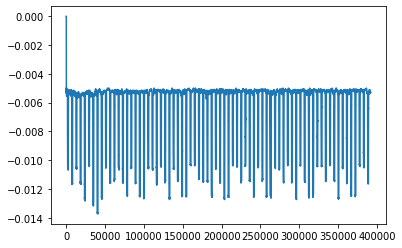

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 18
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 28
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 38
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 48
Wrong pnr snap: 43
Actio

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 308
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 318
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 328
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 588
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 598
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 608
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 618
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 868
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 878
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 888
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 898
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1158
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1168
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1178
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1438
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1448
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1458
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 54
Action:1
RESET: 1718
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1728
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1738
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 1748
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2008
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2018
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2028
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2288
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2298
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2308
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2568
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2578
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2588
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2848
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2858
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2868
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 2878
Wrong pnr snap: 55
Action:0


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3128
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3138
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3148
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3158
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3418
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3428
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3438
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3698
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3708
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3718
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3988
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3995
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 3998
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4008
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0


Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4268
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4278
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4288
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RES

Wrong pnr snap: 55
Action:1
RESET: 4548
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4558
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4568
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4578
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0


Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4838
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4848
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 4858
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wro

Wrong pnr snap: 55
Action:1
RESET: 5118
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5128
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5138
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5148
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0


Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5408
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5418
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:1
RESET: 5428
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr snap: 55
Action:0
Wrong pnr sn

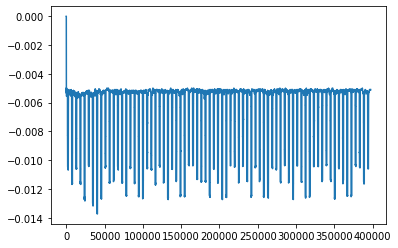

43
Action:1
RESET: 15
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 25
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 35
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 45
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 305
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 315
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 325
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 585
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 595
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 605
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 615
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 875
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 885
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 895
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1155
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1165
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1175
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1435
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1445
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1449
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1455
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Action:1
RESET: 1715
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1725
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1735
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 1745
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2005
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2015
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2025
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2285
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2295
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2305
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2565
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2575
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2585
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2595
Wrong pnr snap: 67


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2845
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2855
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2865
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 2875


Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3125
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3135
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3145
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3155
Wrong pnr snap: 67


Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3405
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3415
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3425
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3435
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Wrong pnr snap: 67
Action:1
RESET: 3685
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3695
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3705
Wrong pnr snap: 67
Action:1
RESET: 3706
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3715
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 

Action:1
RESET: 3965
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3975
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3985
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 3995
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4253
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4255
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4265
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4275
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4535
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4545
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4555
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4815
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4825
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4835
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 4845
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0


Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5105
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5115
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5125
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr sn

Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5385
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5395
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5405
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:0
Wrong pnr snap: 67
Action:1
RESET: 5415
Wrong pnr snap: 67
Action:0


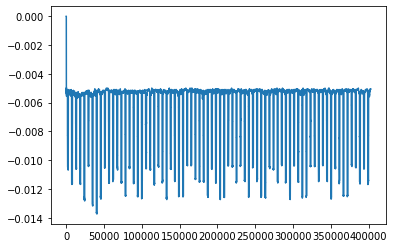

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 22
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 32
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 42
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:1
RESET: 302
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 312
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 322
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 332
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wron

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 592
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 602
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 612
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 872
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 882
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 892
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1152
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1162
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1172
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1182


Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1442
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1452
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1462
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1722
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1732
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1736
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1742
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1752
Wrong p

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2002
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2012
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2021
Wrong pnr snap: 61
Action:1
RESET: 2022
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2032
Wrong p

Action:1
RESET: 2282
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2292
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2302
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2312
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2572
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2582
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2592
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2852
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2862
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2872
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2882
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3142
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3152
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3162
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3422
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3432
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3442
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3702
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3712
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3722
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:1
RESET: 3982
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3992
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4002
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4012
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4272
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4282
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4292
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4552
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4562
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4572
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4582


Action:0
Wrong pnr snap: 61
Action:1
RESET: 4832
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4842
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4852
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4862
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:1
RESET: 5112
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5122
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5132
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5142
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5402
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5412
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5422
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

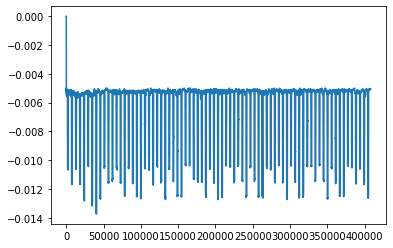

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 19
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 29
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 39
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 309
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 319
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 329
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 589
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 599
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 609
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 869
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 879
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 889
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 899
Wrong pnr snap: 43
Action:0
Wron

Action:1
RESET: 1149
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1159
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1169
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1179
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43


Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1439
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1449
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1459
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wro

Wrong pnr snap: 61
Action:1
RESET: 1719
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1729
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1739
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 1749
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2009
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2019
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2029
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2289
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2299
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2309
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2569
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2579
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2589
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2599
Wrong pnr snap: 61
Action:0


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2859
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2869
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 2879
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3139
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3149
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3159
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3419
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3429
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3439
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3449


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3709
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3719
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3729
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3989
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 3999
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4009
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4269
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4279
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4289
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4549
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4559
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4569
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4579
Wrong pnr snap: 61
Action:0


Action:1
RESET: 4829
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4834
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4839
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4847
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4849
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4859
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 4861
Wrong pnr s

Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5109
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5119
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5129
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5139
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0


Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5399
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5409
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:1
RESET: 5419
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wrong pnr snap: 61
Action:0
Wro

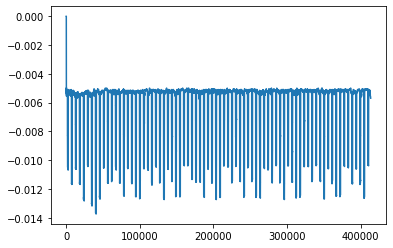

43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 16
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 26
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 36
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 46
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Actio

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 306
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 316
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 326
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET:

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 596
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 606
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 616
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong 

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 876
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 886
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 896
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 906
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Acti

Wrong pnr snap: 43
Action:1
RESET: 1156
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1166
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1176
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1186
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1446
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1456
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 1466
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr sn

Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1726
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1736
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 1746
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wro

Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2006
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2016
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2026
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2036
Wrong pnr snap: 63
Action:0


Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2286
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2296
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2306
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:1
RESET: 2316
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63


Action:1
RESET: 2567
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63
Action:0
Wrong pnr snap: 63


KeyboardInterrupt: 

In [228]:
brain = Dqn(124, 2, 0.9)
old_reward = 0
scores = []
while True:
    oldWrongPnrSnap = 43
    copyDfSes = testDf.copy()
    print(getWrongPnrCount(testDf))

    for ind in range(0, len(copyDfSes) - 32):
        subDf = copyDfSes[ind:ind+31]
        curIndex = ind + 15
        features = []
        for i in range(0, 31):
            elmntId = elmntIdMap[subDf.iloc[i]['elmnt_id']]
            commandGroup = cmndGroupMap[subDf.iloc[i]['command_group']]
            pnrLocChanged = 0 
            resScopeIdChanged = 0
            if i > 0:
                pnrLocChanged = int(subDf.iloc[i -1]['pnr_locator'] != subDf.iloc[i]['pnr_locator'])
                resScopeIdChanged = int(subDf.iloc[i -1]['id'] != subDf.iloc[i]['id'])

            features.append(elmntId)
            features.append(commandGroup)
            features.append(pnrLocChanged)
            features.append(resScopeIdChanged)

        action = brain.update(old_reward, features).item()
        print('Action:' + str(action))
        scores.append(brain.score())
        if(action == 1):
            print('RESET: ' + str(curIndex))
            copyDfSes = resetReservationScopeAndSetPnrLoc(copyDfSes, curIndex)

        newWrongPnrSnap = getWrongPnrCount(copyDfSes)

        newSubDf = copyDfSes[ind+1:ind+31+1] 
        new_features = []
        for i in range(0, 31):
            elmntId = elmntIdMap[newSubDf.iloc[i]['elmnt_id']]
            commandGroup = cmndGroupMap[newSubDf.iloc[i]['command_group']]
            pnrLocChanged = 0 
            resScopeIdChanged = 0
            if i > 0:
                pnrLocChanged = int(newSubDf.iloc[i -1]['pnr_locator'] != newSubDf.iloc[i]['pnr_locator'])
                resScopeIdChanged = int(newSubDf.iloc[i -1]['id'] != newSubDf.iloc[i]['id'])

            new_features.append(elmntId)
            new_features.append(commandGroup)
            new_features.append(pnrLocChanged)
            new_features.append(resScopeIdChanged)

        print('Wrong pnr snap: ' + str(newWrongPnrSnap))
        
        if oldWrongPnrSnap > newWrongPnrSnap: 
            old_reward = oldWrongPnrSnap - newWrongPnrSnap
        elif oldWrongPnrSnap == newWrongPnrSnap: 
            old_reward = -action/ 20
        else:
            old_reward = -1 -action/ 10
        oldWrongPnrSnap = newWrongPnrSnap
        brain.feedback_and_reset(old_reward, new_features)
    save(brain)

In [221]:
learnedBrain = Dqn(124, 2, 0.9)
learnedBrain.load()

=> loading checkpoint...
done !


In [225]:
    scores = []
    oldWrongPnrSnap = 41
    copyDfSes = testDf.copy()
    print(getWrongPnrCount(copyDfSes))

    for ind in range(0, len(copyDfSes) - 32):
        subDf = copyDfSes[ind:ind+31]
        curIndex = ind + 15
        features = []
        for i in range(0, 31):
            elmntId = elmntIdMap[subDf.iloc[i]['elmnt_id']]
            commandGroup = cmndGroupMap[subDf.iloc[i]['command_group']]
            pnrLocChanged = 0 
            resScopeIdChanged = 0
            if i > 0:
                pnrLocChanged = int(subDf.iloc[i -1]['pnr_locator'] != subDf.iloc[i]['pnr_locator'])
                resScopeIdChanged = int(subDf.iloc[i -1]['id'] != subDf.iloc[i]['id'])

            features.append(elmntId)
            features.append(commandGroup)
            features.append(pnrLocChanged)
            features.append(resScopeIdChanged)

        action = learnedBrain.update(old_reward, features).item()
        print('Action:' + str(action))
        scores.append(learnedBrain.score())
        if(action == 1):
            print('RESET: ' + str(curIndex))
            copyDfSes = resetReservationScopeAndSetPnrLoc(copyDfSes, curIndex)

        newWrongPnrSnap = getWrongPnrCount(copyDfSes)

        newSubDf = copyDfSes[ind+1:ind+31+1] 
        new_features = []
        for i in range(0, 31):
            elmntId = elmntIdMap[newSubDf.iloc[i]['elmnt_id']]
            commandGroup = cmndGroupMap[newSubDf.iloc[i]['command_group']]
            pnrLocChanged = 0 
            resScopeIdChanged = 0
            if i > 0:
                pnrLocChanged = int(newSubDf.iloc[i -1]['pnr_locator'] != newSubDf.iloc[i]['pnr_locator'])
                resScopeIdChanged = int(newSubDf.iloc[i -1]['id'] != newSubDf.iloc[i]['id'])

            new_features.append(elmntId)
            new_features.append(commandGroup)
            new_features.append(pnrLocChanged)
            new_features.append(resScopeIdChanged)

        print('Wrong pnr snap: ' + str(newWrongPnrSnap))
        
        if oldWrongPnrSnap > newWrongPnrSnap: 
            old_reward = oldWrongPnrSnap - newWrongPnrSnap
        elif oldWrongPnrSnap == newWrongPnrSnap: 
            old_reward = -action/ 20
        else:
            old_reward = -1 -action/ 10
        oldWrongPnrSnap = newWrongPnrSnap
    plt.plot(scores)
    plt.show()

43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


<ipython-input-220-4a0aa3d6300a>:59: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.
  probs = F.softmax(self.model(Variable(state, volatile = True))*100)
<ipython-input-220-4a0aa3d6300a>:59: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  probs = F.softmax(self.model(Variable(state, volatile = True))*100)


Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
A

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr s

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr s

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 913
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
A

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
A

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr s

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
A

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 2401
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 2408
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap:

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:1
RESET: 2688
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pn

Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
A

Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0
Wrong pnr snap: 43
Action:0


KeyboardInterrupt: 

In [135]:
def save(brain):
    print('Saving ...')
    brain.save()
    plt.plot(scores)
    plt.show()

In [185]:
copyDfSes

,index,evn_tms,elmnt_id,flow_command,command_group,pnr_locator,id,value,val
0,60889,2021-08-11 08:03:09.000828 -05:00,sabre-ngv-app,¤A,CHANGE_AREA,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
1,60890,2021-08-11 08:03:09.000828 -05:00,sabre-ngv-app,NGV://USERCONFIG,NGV://USERCONFIG,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
2,60891,2021-08-11 08:03:09.000828 -05:00,sabre-ngv-app,NGV://CFEVENT,NGV://CFEVENT,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
3,60892,2021-08-11 08:03:11.000368 -05:00,sabre-ngv-app,NGV://AREALABEL/READ,NGV://AREALABEL/READ,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
4,60893,2021-08-11 08:03:12.000543 -05:00,sabre-ngv-app,NGV://USERCONFIG,NGV://USERCONFIG,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
...,...,...,...,...,...,...,...,...,...
6801,67611,2021-08-11 16:28:13.000517 -05:00,sabre-ngv-app,NGV://CFEVENT,NGV://CFEVENT,XHRPJZ,eb206b02-cf93-4b48-84d6-3e44c915b76b,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
6802,67612,2021-08-11 16:28:13.000523 -05:00,sabre-ngv-app,NGV://RESERVATIONSCOPE/LOCATOR,NGV://RESERVATIONSCOPE/LOCATOR,XHRPJZ,eb206b02-cf93-4b48-84d6-3e44c915b76b,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
6803,67613,2021-08-11 16:28:15.000270 -05:00,sabre-ngv-hotkeys,QC/18,Q_CNT,nan,363977f6-2caf-4edb-a7c2-b4bcc1fb6240,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
6804,67614,2021-08-11 16:28:17.000301 -05:00,sabre-ngv-hotkeys,SO*,SIGN_OUT,nan,363977f6-2caf-4edb-a7c2-b4bcc1fb6240,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN


In [223]:
copyDfSes[['pnr_locator', 'val', 'id','elmnt_id','flow_command','command_group']].to_csv('./fixed.csv')


In [14]:
features = []
for i in range(0, 31):
    elmntId = elmntIdMap[subDf.iloc[i]['elmnt_id']]
    commandGroup = cmndGroupMap[subDf.iloc[i]['command_group']]
    pnrLocChanged = 0 
    resScopeIdChanged = 0
    if i > 0:
        pnrLocChanged = int(subDf.iloc[i -1]['pnr_locator'] != subDf.iloc[i]['pnr_locator'])
        resScopeIdChanged = int(subDf.iloc[i -1]['id'] != subDf.iloc[i]['id'])

    features.append(subDf.iloc[i]['index'])
    features.append(elmntId)
    features.append(commandGroup)
    features.append(pnrLocChanged)
    features.append(resScopeIdChanged)

features

[60889,
 0.9,
 0.851063829787234,
 0,
 0,
 60890,
 0.9,
 0.5212765957446809,
 0,
 0,
 60891,
 0.9,
 0.6914893617021277,
 0,
 0,
 60892,
 0.9,
 0.43617021276595747,
 0,
 0,
 60893,
 0.9,
 0.5212765957446809,
 0,
 0,
 60894,
 0.9,
 0.7659574468085106,
 0,
 0,
 60895,
 0.9,
 0.18085106382978725,
 0,
 0,
 60896,
 0.9,
 0.2127659574468085,
 0,
 0,
 60897,
 0.9,
 0.2765957446808511,
 0,
 0,
 60898,
 0.9,
 0.3617021276595745,
 0,
 0,
 60899,
 0.4,
 0.9361702127659575,
 0,
 0,
 60900,
 0.9,
 0.5212765957446809,
 0,
 0,
 60901,
 1.0,
 0.19148936170212766,
 0,
 0,
 60902,
 0.9,
 0.6914893617021277,
 0,
 0,
 60903,
 0.2,
 0.5106382978723404,
 0,
 0,
 60904,
 0.2,
 0.7659574468085106,
 0,
 0,
 60905,
 0.9,
 0.3617021276595745,
 0,
 1,
 60906,
 0.9,
 0.5212765957446809,
 0,
 0,
 60907,
 0.9,
 0.18085106382978725,
 0,
 0,
 60908,
 0.9,
 0.7127659574468085,
 0,
 0,
 60909,
 0.2,
 0.851063829787234,
 0,
 0,
 60910,
 0.9,
 0.3617021276595745,
 0,
 1,
 60911,
 0.9,
 0.7659574468085106,
 0,
 0,
 60912,
 

In [52]:
def getWrongPnrCount(df):
    return len(df[(df['elmnt_id'] == "PNR_SNAPSHOT") & ((df['val'].notnull() & df['pnr_locator'].isnull()) | 
      (df['val'].isnull() & df['pnr_locator'].notnull()) | 
     (df['val'].notnull() & df['pnr_locator'].notnull() & ~(df['val'] == df['pnr_locator'])))])

In [73]:
dfSes.head(50)

,index,evn_tms,elmnt_id,flow_command,command_group,pnr_locator,id,value,val
0,60889,2021-08-11 08:03:09.000828 -05:00,sabre-ngv-app,¤A,CHANGE_AREA,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
1,60890,2021-08-11 08:03:09.000828 -05:00,sabre-ngv-app,NGV://USERCONFIG,NGV://USERCONFIG,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
2,60891,2021-08-11 08:03:09.000828 -05:00,sabre-ngv-app,NGV://CFEVENT,NGV://CFEVENT,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
3,60892,2021-08-11 08:03:11.000368 -05:00,sabre-ngv-app,NGV://AREALABEL/READ,NGV://AREALABEL/READ,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
4,60893,2021-08-11 08:03:12.000543 -05:00,sabre-ngv-app,NGV://USERCONFIG,NGV://USERCONFIG,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
5,60894,2021-08-11 08:03:14.000450 -05:00,sabre-ngv-app,S/*,UNDEFINED,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
6,60895,2021-08-11 08:03:14.000481 -05:00,sabre-ngv-app,NGV://ADVANCEDCONTEXT,NGV://ADVANCEDCONTEXT,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
7,60896,2021-08-11 08:03:17.000220 -05:00,sabre-ngv-app,NGV://INIT,NGV://INIT,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
8,60897,2021-08-11 08:03:17.000234 -05:00,sabre-ngv-app,NGV://AGENCYPROFILE,NGV://AGENCYPROFILE,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
9,60898,2021-08-11 08:03:17.000248 -05:00,sabre-ngv-app,NGV://FULLTIR,NGV://FULLTIR,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN


In [74]:
resetReservationScopeAndSetPnrLoc(dfSes, 32).head(50)

index                                                        60921
evn_tms                          2021-08-11 08:03:34.000462 -05:00
elmnt_id                                         sabre-ngv-hotkeys
flow_command                                                  Q/59
command_group                                           Q_DISP_PNR
pnr_locator                                                    nan
id                            065a2088-d300-4b0d-be50-dd787a0395b5
value            T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...
val                                                            NaN
Name: 32, dtype: object
index                                                        60922
evn_tms                          2021-08-11 08:03:34.000733 -05:00
elmnt_id                                             sabre-ngv-app
flow_command                                         NGV://FULLTIR
command_group                                        NGV://FULLTIR
pnr_locator                           

,index,evn_tms,elmnt_id,flow_command,command_group,pnr_locator,id,value,val
0,60889,2021-08-11 08:03:09.000828 -05:00,sabre-ngv-app,¤A,CHANGE_AREA,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
1,60890,2021-08-11 08:03:09.000828 -05:00,sabre-ngv-app,NGV://USERCONFIG,NGV://USERCONFIG,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
2,60891,2021-08-11 08:03:09.000828 -05:00,sabre-ngv-app,NGV://CFEVENT,NGV://CFEVENT,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
3,60892,2021-08-11 08:03:11.000368 -05:00,sabre-ngv-app,NGV://AREALABEL/READ,NGV://AREALABEL/READ,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
4,60893,2021-08-11 08:03:12.000543 -05:00,sabre-ngv-app,NGV://USERCONFIG,NGV://USERCONFIG,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
5,60894,2021-08-11 08:03:14.000450 -05:00,sabre-ngv-app,S/*,UNDEFINED,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
6,60895,2021-08-11 08:03:14.000481 -05:00,sabre-ngv-app,NGV://ADVANCEDCONTEXT,NGV://ADVANCEDCONTEXT,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
7,60896,2021-08-11 08:03:17.000220 -05:00,sabre-ngv-app,NGV://INIT,NGV://INIT,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
8,60897,2021-08-11 08:03:17.000234 -05:00,sabre-ngv-app,NGV://AGENCYPROFILE,NGV://AGENCYPROFILE,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN
9,60898,2021-08-11 08:03:17.000248 -05:00,sabre-ngv-app,NGV://FULLTIR,NGV://FULLTIR,nan,6415f9f2-4766-49a2-a466-2b25eef550af,T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xzi...,NaN


In [179]:
def resetReservationScopeAndSetPnrLoc(df, index):

    curPnrLoc = df.iloc[index]['pnr_locator']
    curIdd = df.iloc[index]['id']

    newPnrLoc = ''
    newResScopeId = ''

    for i in range(index, index + 10):
        pnrToCheck = df.iloc[i]['pnr_locator']
        idd = df.iloc[i]['id']
        if pnrToCheck != curPnrLoc and idd != curIdd:
            newPnrLoc = pnrToCheck
            newResScopeId = idd
            break
        if pnrToCheck != curPnrLoc:
            newPnrLoc = pnrToCheck
            break
      
    if newPnrLoc != '':
        for i in range(index, max(df.index)):
            df.at[i, 'pnr_locator'] = newPnrLoc
            currentId = df.iloc[i]['id']
            if newResScopeId == '':
                df.at[i, 'id'] = currentId + '_added'
            else: 
                df.at[i, 'id'] = newResScopeId

            if currentId != df.iloc[i+1]['id']:
                break
            
    return df

In [ ]:
def updatePnrLocator(df, index):

In [224]:
testDf = allDf[allDf['value'] == 'T1RLAQLHWDY+Nf8DjfPwjEo41exzazGVzxDXbLBWCti7vfrgxdI7ri99AADAUurGEymdeljnOcS8Q2NpM9l/LdZFgAwU2gk77XoePO8lWg3SBcmXV9GWADnEpbb9fu/fFvQOzX9ptBT8nRtpFtlNhbQ0XSYSpfMHnhSZzTB7Y8gnhRD00BVOfkYU77FMUF/lzr5rgUzbbCshU5fgZ2S0rwOzuhrFhHN0xJQNQA0+7twBKI2aPsRWoi6ySdgDjMtsXA/1JqztIfXCJ8D2N7jtF+TqK+ylYFZ/lrjMW/3KKJADAe5qb3Sx+ovkZcmM']

In [197]:
getWrongPnrCount(testDf)

43

In [45]:
getWrongPnrCount(allDf[allDf['value'] == 'T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xziATHElGn6MbAADAY1C7I5L6WCBIRgLz81HhKsChLyr3L5BnNlUj4dWBz2Y+7TtuNSyRfFqOtdLSu8MP5PSvVcXcpJovj18L/BwaSqeaA6Ausea10IWDwChV8NQOG5hNliKN5LjUJfQixkjgSpjhx5jesTy+/eIU2pENDCjKF6jEfLTYC1cUDw2WITegG3f1TVvynkU6Erk7yv5c8c+5DUPCBxsiYji8/bcLnnCL5AYF7NYXZ2iiYt3hKPMWwIMbQEtBu5Fcb30x+XwV'])

41

In [33]:
def getAllFeatures(df):
    

3591

In [41]:
allDf.groupby('value').count().sort_values(by='elmnt_id', ascending=False)

,evn_tms,elmnt_id,flow_command,command_group,pnr_locator,id,val
value,,,,,,,
T1RLAQLsRcnEhUpzRlfJEyofwoNpne/BxhB27TVjsd3xziATHElGn6MbAADAY1C7I5L6WCBIRgLz81HhKsChLyr3L5BnNlUj4dWBz2Y+7TtuNSyRfFqOtdLSu8MP5PSvVcXcpJovj18L/BwaSqeaA6Ausea10IWDwChV8NQOG5hNliKN5LjUJfQixkjgSpjhx5jesTy+/eIU2pENDCjKF6jEfLTYC1cUDw2WITegG3f1TVvynkU6Erk7yv5c8c+5DUPCBxsiYji8/bcLnnCL5AYF7NYXZ2iiYt3hKPMWwIMbQEtBu5Fcb30x+XwV,6806,6806,6662,6662,4211,6806,79
T1RLAQL52m4X8lyr1JExley0vc7BKI13oRDNfLJGuRbkXZDkg6IsmtFZAADAUrcbSKnVCz9sgK0rB+7gqhQsB0hanQ2WD5/vJQAB+Bv3sg1ln/SE6ZCPjy7YbH+BpL9AHbdi6axJDoEzjVMjNbjYzBn2Kk2EnDl1BeZd+gxhkg7JQy6kbc800PKAo1juqdiNVZZQ3r6qRDNg9aljjtUyhuPRMJtwfaLCX0BRRaLxY08YhuI4MXS3kLvdgh55DunWyw3CqRTk+xd9z4gZQMQUcfODDAlxFlXK9WTLTlZZLvnKNEVQVRM5ziRptnFT,6638,6638,6476,6476,4056,6638,97
T1RLAQLHWDY+Nf8DjfPwjEo41exzazGVzxDXbLBWCti7vfrgxdI7ri99AADAUurGEymdeljnOcS8Q2NpM9l/LdZFgAwU2gk77XoePO8lWg3SBcmXV9GWADnEpbb9fu/fFvQOzX9ptBT8nRtpFtlNhbQ0XSYSpfMHnhSZzTB7Y8gnhRD00BVOfkYU77FMUF/lzr5rgUzbbCshU5fgZ2S0rwOzuhrFhHN0xJQNQA0+7twBKI2aPsRWoi6ySdgDjMtsXA/1JqztIfXCJ8D2N7jtF+TqK+ylYFZ/lrjMW/3KKJADAe5qb3Sx+ovkZcmM,5475,5475,5266,5268,4499,5475,170
T1RLAQJ67YxApmVDdn7Mfuv2AmnDh3TiRBCUMCw6t2vHeyT/lRgrV2a9AADAm3f1QRgvf6mG/5OtQvUl8soCxrfFw45DnFupSGsZC8MzODO0h6/wKPmW17C/rxw3VsizUm5Y9MV5fjyPjKhhp5qYav5OAaBlPy7XoA9grH6szTfEMqWO/fWcYZKr4IpYb9v1B690LbXAJL6IGfMD7QIm/LNwCkjmUSRvf4ehy0foCwt+JoZLZl5TM3tBziuzZqAc0V8QGqPWTuEU/yCme7SG2/azITng3+yojJlg0dZsQxQP1R6SZEhsn0r1Chrm,5235,5235,5180,5180,3832,5235,0
T1RLAQJ+LQ8itP4y+mDIMqD8AM6Sqs9KtBABuyWoOLvwKSXWZg274gORAADA7lNfZQZE2Qk98kRAvhHFujEpkC4JPqDR4vQCVcuqvZxi8SlDtpiFtzkqMQKsvDDgQUapPf3FucfLH8ZwgugN+BdK/qW8GiZIua15sx0Ui0EUoy0FDzbufFdJuLY3V+zkNBLN+1KFHWGTOjv6arsIu85NN/QVZU50m4LVRhp2S8Qa+HRPhmj0JWjj7GKy+emAvUkM9/NtOVirRzT23GLlpPsxFC9pnJHB8DLnhWVSLndFhszhzmXt55+4Zb+G2fPt,5158,5158,5135,5135,4037,5158,1
...,...,...,...,...,...,...,...
T1RLAQJcOeL4NPVjfrDyTlQQX6CZJK0TyBD7XrGVUsf6xAPAgEezsiboAADAR/iWb5kVZXGJTQ+gZIulvfS2bhUlIVjdAfJo+otrVVx4hZYaknWPkZ655QM1x79Jaa6uXPYwcxzjGavMkBIxf6gJyOb7Vz+cTWt3+iwJBE3oxbwFHQD0RfuhC6AcWZGiyH9641pufDpnXrVTLy2198rjg79X491fAD1ROY8qUw0S9l2LyVeMeA51T+g+Rs9CnmK5KUDbqiuglbyjyRY8y5G7Y8JOvkwu4rZ9ACNOmUD5TIoYRSvdxmIT23Ux6RTY,1,1,0,0,1,1,1
T1RLAQLLSpVurx7zB7MKjo51NvNd4pV+ghA7hfUPPmmB0F2uZS0vyUsNAADA8ijingb2MBr7DdOLbVQSDTuRSrYcf1eccjrxYjGC3dKKalbRwkduossD9G41IJAuU26cJW9a8KcuUQce7DNWyGGqWEU+D/bJwalnQ1B8f7+YumhuilrOYYiT+qDM2+RBCqSnx3/AdaBk7HB3Sa7mAAv0ct28QGE4xJry1EBfDEAJyBJHu+XBtezpP2ZE9QUEy0MTvTEiinoAZKCk27kYLQyW+6J8aRev6o1c3eNsNiLVeTONCHLR3pkfNrx6ztc+,1,1,0,0,0,1,1
T1RLAQJYVtIFkhbiGs3uV6YA48fjVn2yqBAA4Llb3cnNF9778kypi9VcAADAfKw7YVrsYPgilv0uzn2qEkeShGJdDBUaDV9y9t1kQ/O9xr7YiKakECOUcXWiMzWr+BbrA0AxaRG9B5jUCwYjO98NlMHvXtNrPXQQSp4TsTqV68qKaMQRUHW7ECqE2ya6Brg/pTBKak3nRiWJ01FpL0xMaDNm8nvZYP9BEsp/yH5DEsa6ZYq21EdNnMZVS0VNKZqiVr+QodPy00q1tJvN/A8In1em38ef9AZ3ZlMVezVPqDmAa4UamX24rNVKM9YJ,1,1,0,0,1,1,1


In [226]:


import numpy as np
import random
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.autograd as autograd
from torch.autograd import Variable
import threading

class Network(nn.Module):
    
    def __init__(self, input_size, nb_action):
        super(Network, self).__init__()
        self.input_size = input_size
        self.nb_action = nb_action
        self.fc1 = nn.Linear(input_size, 100)
        self.fc2 = nn.Linear(100,80)
        self.fc3 = nn.Linear(80, nb_action)
        
    def forward(self, state):
        x = F.relu(self.fc1(state))
        x = F.relu(self.fc2(x))
        q_values = self.fc3(x)
        return q_values

class ReplayMemory(object):
    def __init__(self, capacity):
        self.capacity = capacity
        self.memory = []        
        # update the memory 
        # append the transition
        
    def push(self, event):
        self.memory.append(event)
        if len(self.memory) > self.capacity:
            del self.memory[0]
            
    def sample(self, batch_size):
        samples = zip(*random.sample(self.memory, batch_size))
        return map(lambda x: Variable(torch.cat(x, 0)), samples)
        
class Dqn():
    
    def __init__(self, input_size, nb_action, gamma):
        self.gamma = gamma
        self.reward_window = []
        self.model = Network(input_size, nb_action)
        self.memory = ReplayMemory(100000)
        self.optimizer = optim.Adam(self.model.parameters(), lr = 0.001)
        self.last_state = torch.Tensor(input_size).unsqueeze(0)
        self.last_action = 0
        self.last_reward = 0
        self.iter = 0
        
    def select_action(self, state):
        with torch.no_grad():
            probs = F.softmax(self.model(Variable(state, volatile = True))*100)
            action = probs.multinomial(num_samples=1 )
            self.iter = self.iter + 1
            if self.iter % 10 == 0:
                return torch.tensor([[1]])[0,0]
            else:
                return action.data[0,0]

    def learn(self, batch_state, batch_next_state, batch_reward, batch_action):
        outputs = self.model(batch_state).gather(1, batch_action.unsqueeze(1)).squeeze(1)
        next_outputs = self.model(batch_next_state).detach().max(1)[0]
        target = self.gamma * next_outputs + batch_reward
        td_loss = F.smooth_l1_loss(outputs, target)
        self.optimizer.zero_grad()
        td_loss.backward()
        self.optimizer.step()
        
    def feedback_and_reset(self,reward, new_signal):
        new_state = torch.Tensor(new_signal).float().unsqueeze(0)
        self.memory.push((self.last_state, new_state, torch.LongTensor([int(self.last_action)]), torch.Tensor([reward])))
        
    def update(self, reward, new_signal):
        new_state = torch.Tensor(new_signal).float().unsqueeze(0)
        action = self.select_action(new_state)
        if len(self.memory.memory) > 100:
            batch_state, batch_next_state, batch_action, batch_reward = self.memory.sample(100)
            self.learn(batch_state, batch_next_state, batch_reward, batch_action)
        self.last_action = action
        self.last_state = new_state
        self.last_reward = reward
        self.reward_window.append(reward)
        if len(self.reward_window) > 1000:
            del self.reward_window[0]
        return action
    
    def score(self):
        return sum(self.reward_window)/(len(self.reward_window) +1.)
    
    def save(self):
        torch.save({'state_dict': self.model.state_dict(),
                    'optimizer': self.optimizer.state_dict(),
                   }, 'last_brain_2.pth')
        
    def load(self):
        if os.path.isfile('./last_brain.pth'):
            print("=> loading checkpoint...")
            checkpoint = torch.load('last_brain.pth')
            self.model.load_state_dict(checkpoint['state_dict'])
            self.optimizer.load_state_dict(checkpoint['optimizer'])
            print("done !")
        else:
            print("no checkpoint found...")
        

In [ ]:
print(torch.__version__)


In [ ]:
'cos_tam'.split('_')[0]